# Imports

In [104]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from ete3 import Tree
import pickle
from tqdm import tqdm
import torch
import gc
import seaborn as sns
from matplotlib.lines import Line2D
import gseapy
import gc
import time

from scores import get_expected_lac_bmtm_height_perm, get_perm_dists, get_lac_for_all_genes
from scores import lac_empirical, lac_theoretical, get_lac_for_all_subtrees_all_genes
from plotting import double_tree_plot, nice_colors, get_tsne, kp_color_domain, single_tree_plot
from plotting import NAN_COLOR_VALUE
from tree_util import get_tree_dists, get_node_and_edge_data, make_binary_tree
from tree_util import augment_tree_with_weights
from sim_util import generate_bmtm_data_from_tree
from perm_util import extract_subsets_with_height, get_permutation_ids
from model import TreeGeneModel
from training import optimize_weights

data_path = './data'
results_path = './results'

# Figure 4

## Worm t-SNE

/tmp/ipykernel_3970657/355678680.py:12: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


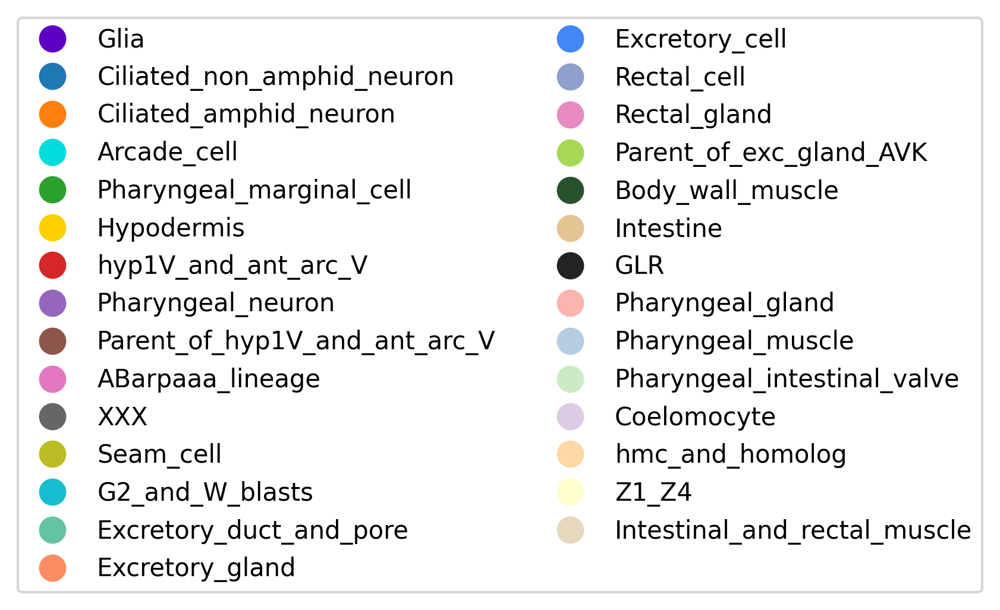

In [2]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

legend_elements = []
for color, cell_type in zip(additional_colors, additional_color_domain):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=2)
fig.tight_layout()

/tmp/ipykernel_3970657/322438421.py:14: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


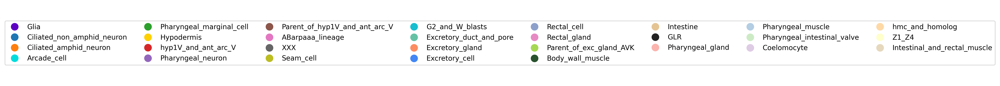

In [3]:
from matplotlib.lines import Line2D

cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

legend_elements = []
for color, cell_type in zip(additional_colors, additional_color_domain):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=8)
fig.tight_layout()

In [7]:
cell_types[cell_types['type'].isna()]

,type
leaf,
ABALAAAALAL,NaN
ABALAAAALP,NaN
ABALAAAARLP,NaN
ABALAAAARR,NaN
ABALAAAPALR,NaN
...,...
MSAPAAP,NaN
MSPAAAPP,NaN
MSPAPAPP,NaN


In [8]:
cell_types['type'].isna().sum()

129

In [9]:
print('\n'.join(cell_types[cell_types['type'].isna()].index))

ABALAAAALAL
ABALAAAALP
ABALAAAARLP
ABALAAAARR
ABALAAAPALR
ABALAAAPAR
ABALAAAPPR
ABALAAPAAA
ABALAAPPAPA
ABALAAPPPAA
ABALAPAAAAA
ABALAPAAAPA
ABALAPAPPPA
ABALAPPAAPA
ABALAPPAPA
ABALAPPAPP
ABALAPPPAAA
ABALAPPPPP
ABALPAAAAA
ABALPAAAAP
ABALPAAAPA
ABALPAAAPP
ABALPAPAAA
ABALPAPAPAA
ABALPAPAPAPP
ABALPAPAPP
ABALPAPPPP
ABALPPAAAP
ABALPPAAPP
ABALPPAPAA
ABALPPAPAP
ABALPPAPPAA
ABALPPPAAAA
ABALPPPAAP
ABALPPPPPPPP
ABARAAAAAA
ABARAAAAPA
ABARAAAPAA
ABARAAAPAP
ABARAAAPPA
ABARAAAPPP
ABARAAPAAA
ABARAAPPAP
ABARAAPPP
ABARAPAAA
ABARAPAAP
ABARAPAPAPP
ABARAPAPP
ABARAPPAAA
ABARAPPAP
ABARAPPPA
ABARAPPPPA
ABARPAAPP
ABARPAPAAA
ABARPPAAPPA
ABARPPPAA
ABARPPPAPP
ABPLAAAAP
ABPLAAAPA
ABPLAAAPP
ABPLAAPAAP
ABPLAAPAPPA
ABPLAPAAAPAD
ABPLAPAAAPAV
ABPLAPAPAA
ABPLAPAPAP
ABPLAPPAAP
ABPLAPPPAAA
ABPLAPPPAPPP
ABPLAPPPPA
ABPLAPPPPP
ABPLPAAAPA
ABPLPAAPAAA
ABPLPAAPAAP
ABPLPAAPPAP
ABPLPAAPPPA
ABPLPAPAAAP
ABPLPAPAAPA
ABPLPAPAAPP
ABPLPAPAPAP
ABPLPAPAPP
ABPLPAPPPPA
ABPLPPAAAAPP
ABPLPPAAPAP
ABPLPPAAPP
ABPLPPAPAP
ABPLPPAPPA
ABPLPPAPPP
ABPL

/tmp/ipykernel_3970657/3617024638.py:16: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


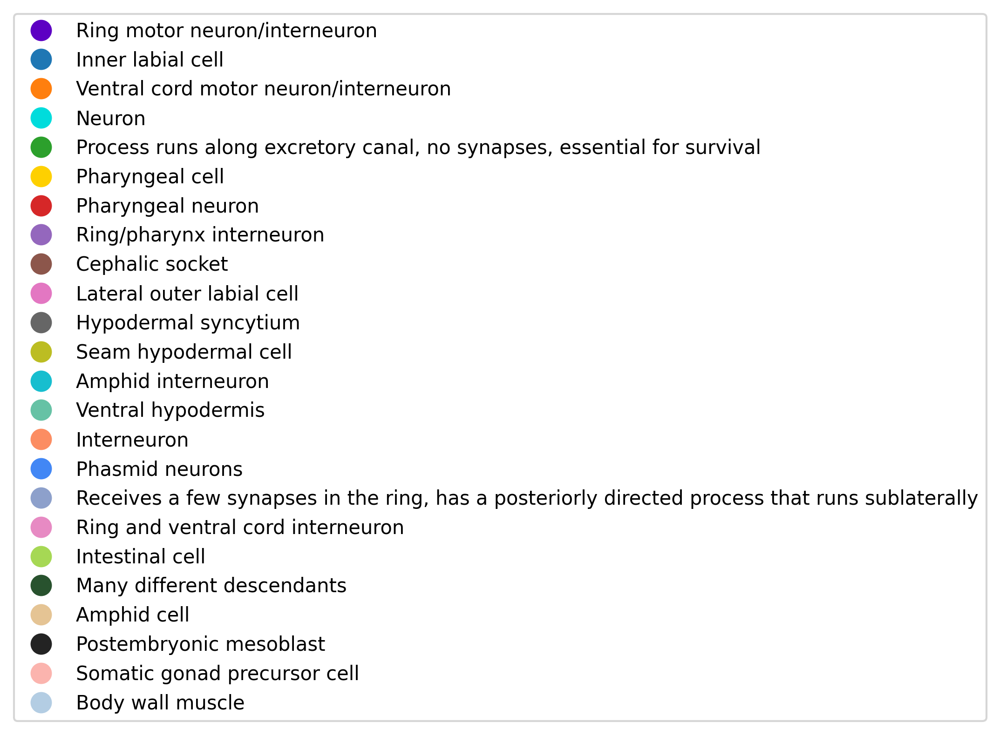

In [6]:
extra_cell_types_2 = pd.read_csv(f'{data_path}/worm/extra_cell_types_v2.csv', index_col='leaf')
supp_cell_types_2 = cell_types.copy()
supp_cell_types_2['type'] = np.NaN
supp_cell_types_2.loc[extra_cell_types_2.index] = extra_cell_types_2

extra_color_domain_2 = supp_cell_types_2['type'].dropna().unique().tolist()
extra_colors_2 = nice_colors[1:1+len(extra_color_domain_2)]

legend_elements = []
for color, cell_type in zip(extra_colors_2, extra_color_domain_2):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=1)
fig.tight_layout()

In [10]:
name = 'worm_avg_leaves'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'


norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
np.random.seed(134141)
gene_tsne = get_tsne(norm_expression.values)

/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


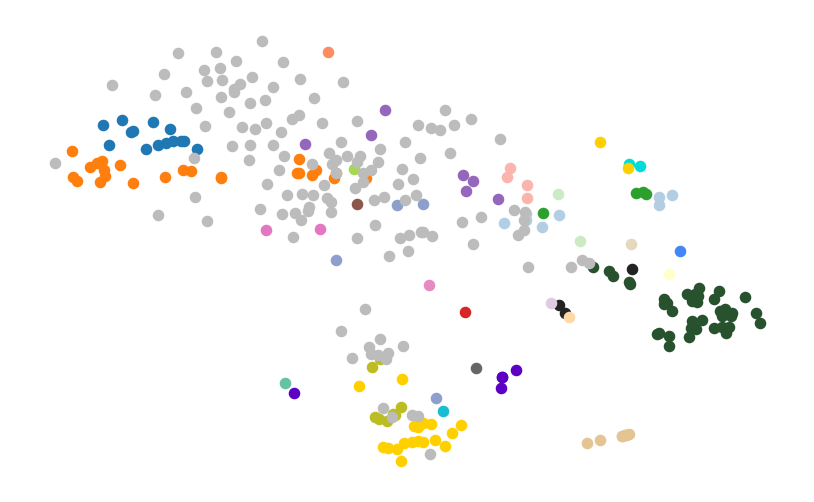

In [11]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3), dpi=200)
for c, t in zip(additional_colors, additional_color_domain):
  ax.scatter(x=gene_tsne[(cell_types.loc[norm_expression.index] == t).values.flatten(), 0],
             y=gene_tsne[(cell_types.loc[norm_expression.index] == t).values.flatten(), 1],
             color=c, s=10)
ax.scatter(x=gene_tsne[(cell_types.loc[norm_expression.index].isna()).values.flatten(), 0],
            y=gene_tsne[(cell_types.loc[norm_expression.index].isna()).values.flatten(), 1],
            color=nice_colors[0], s=10)
ax.axis('off')
fig.show()

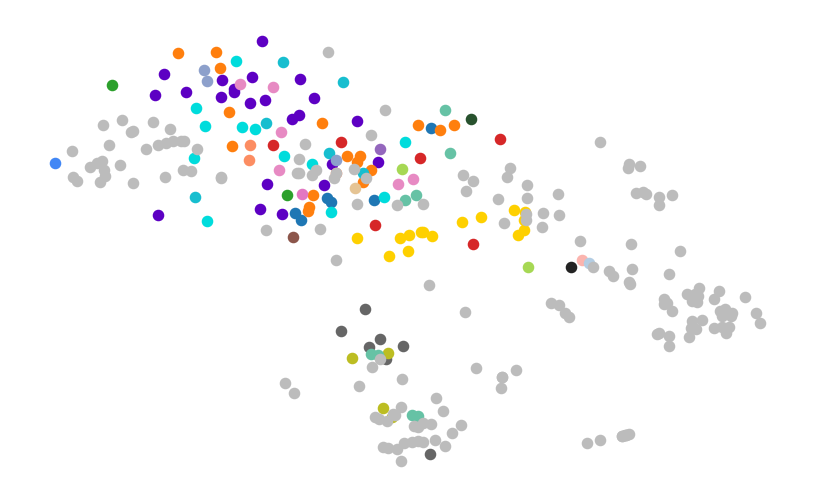

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3), dpi=200)
for c, t in zip(extra_colors_2, extra_color_domain_2):
  ax.scatter(x=gene_tsne[(supp_cell_types_2.loc[norm_expression.index] == t).values.flatten(), 0],
             y=gene_tsne[(supp_cell_types_2.loc[norm_expression.index] == t).values.flatten(), 1],
             color=c, s=10)
ax.scatter(x=gene_tsne[(supp_cell_types_2.loc[norm_expression.index].isna()).values.flatten(), 0],
            y=gene_tsne[(supp_cell_types_2.loc[norm_expression.index].isna()).values.flatten(), 1],
            color=nice_colors[0], s=10)
ax.axis('off')
fig.show()

## Worm edge weight optimization

### Optimize full tree

epoch: 1000; score: 174.671388843098526; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:12<00:00, 79.11it/s]


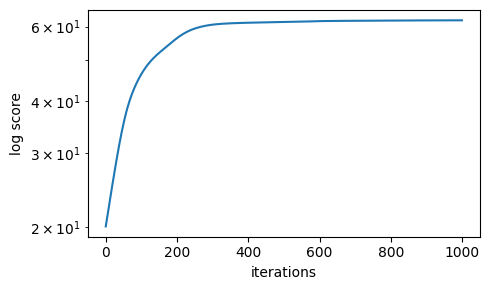

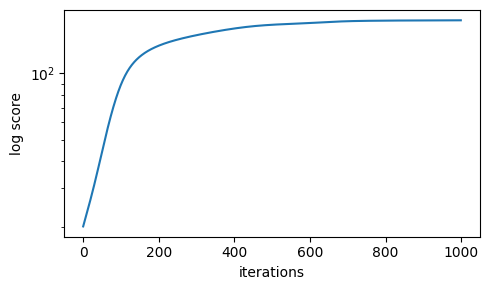

In [17]:
name = 'worm_avg_leaves'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'

# scores for all genes before optimization
tree_dists, _ = get_tree_dists(Tree(tree_path, quoted_node_names=True, format=1), labels_in_order)
gene_scores = get_lac_for_all_genes(tree_dists, expression)
gene_scores = gene_scores.sort_values('score', ascending=False)
gene_scores.to_csv(f'{results_path}/scores/worm/{name}_scores.csv')

# scores for subtrees before optimization
scores_subtree, scores_remaining = get_lac_for_all_subtrees_all_genes(
    tree_path, expression[gene_scores.index], gene_group_size=500, device='cuda:0')

scores_subtree.to_csv(f'{results_path}/scores/worm/{name}_scores_subtree.csv')
scores_remaining.to_csv(f'{results_path}/scores/worm/{name}_scores_remaining.csv')
gc.collect()
torch.cuda.empty_cache()

# optimize just edge weights
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
use_genes = gene_scores.index[:1000]
model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes),
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0',
                            gene_group_size=200, use_float=True)
loss_fig.show()
ew_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ew_df = pd.concat([ew_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)),
                                       index=model.skip_edges_ends, columns=['weight'])])
ew_df.to_csv(f'{results_path}/scores/worm/{name}_ew.csv')

del model
gc.collect()
torch.cuda.empty_cache()

# optimize both gene and edge weights
model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
loss_fig.show()
ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)),
                                         index=model.skip_edges_ends, columns=['weight'])])
gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                     index=use_genes, columns=['weight'])
ewg_df.to_csv(f'{results_path}/scores/worm/{name}_ewg.csv')
gw_df.to_csv(f'{results_path}/scores/worm/{name}_gw.csv')

del model
gc.collect()
torch.cuda.empty_cache()

### Optimize AB and remaining subtree separately

epoch: 1000; score: 28.689779435216781; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:09<00:00, 105.19it/s]


Endo-dominant subtree edge weights P0A_P0A        0.500000
ABA_ABA        0.028570
ABP_ABP        0.028570
ABAL_ABAL      1.529130
ABAR_ABAR      0.040531
                 ...   
ABPRPPPAAAA    0.719988
ABPRPPPPAA     1.875256
ABPRPPPPAPA    2.531451
ABPRPPPPAPP    2.504353
ABPRPPPPP      2.817017
Name: weight, Length: 421, dtype: float32


epoch: 1000; score: 19.073517732467621; : 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 99.82it/s]


Other subtree edge weights N0000      0.500000
P1_P1      0.500000
EMS_EMS    0.566784
P2_P2      0.566784
E_E        1.111031
             ...   
DAPPAA     1.797370
DAPPPA     2.281641
DPAP       2.028405
DPPPA      2.457615
DPPPP      2.522872
Name: weight, Length: 168, dtype: float32


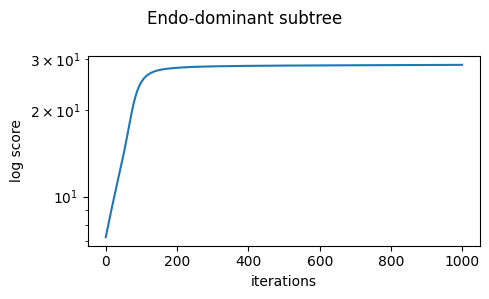

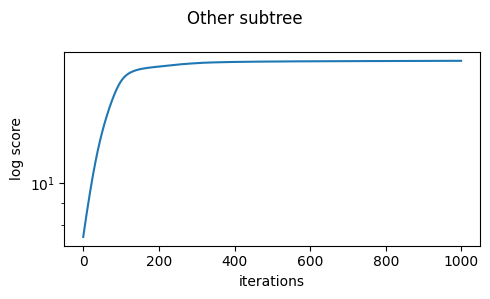

In [18]:
etree = Tree(tree_path, quoted_node_names=True, format=1)
etree_copy = etree.copy()
ab_root = 'P0A_P0A'
ab_subtree = etree_copy.search_nodes(name=ab_root)[0].detach()
other_subtree = etree_copy
ab_tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ab_subtree.write(outfile=ab_tree_path, format=1)
other_tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
other_subtree.write(outfile=other_tree_path, format=1)
ab_subtree_labels = ab_subtree.get_leaf_names()
other_subtree_labels = other_subtree.get_leaf_names()
ab_expression = expression.loc[ab_subtree_labels]
other_expression = expression.loc[other_subtree_labels]

ab_norm_expression = ((ab_expression - ab_expression.mean(axis=0))/ab_expression.std(axis=0))
ab_model = TreeGeneModel(ab_tree_path, ab_norm_expression.index, gene_dim=len(use_genes),
                         skip_tip_distance=-1, decay_factor=10, quoted_node_names=True)
loss_fig = optimize_weights(ab_model, ab_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
ab_ew_df = pd.DataFrame(torch.exp(ab_model.log_edge_weights.detach()).cpu().numpy(),
                        index=pd.Series(ab_model.edges_ends).str.replace('N0000', ab_root), columns=['weight'])
loss_fig.suptitle('Endo-dominant subtree')
loss_fig.tight_layout()
loss_fig.show()
print('Endo-dominant subtree edge weights', ab_ew_df['weight'])

del ab_model
gc.collect()
torch.cuda.empty_cache()

other_norm_expression = ((other_expression - other_expression.mean(axis=0))/other_expression.std(axis=0))
other_model = TreeGeneModel(other_tree_path, other_norm_expression.index, gene_dim=len(use_genes),
                          skip_tip_distance=-1, decay_factor=10, quoted_node_names=True)
loss_fig = optimize_weights(other_model, other_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
other_ew_df = pd.DataFrame(torch.exp(other_model.log_edge_weights.detach()).cpu().numpy(), index=other_model.edges_ends, columns=['weight'])
loss_fig.suptitle('Other subtree')
loss_fig.tight_layout()
loss_fig.show()
print('Other subtree edge weights', other_ew_df['weight'])

del other_model
gc.collect()
torch.cuda.empty_cache()

ab_ew_df.to_csv(f'{results_path}/scores/worm/{name}_ab_ew.csv')
other_ew_df.to_csv(f'{results_path}/scores/worm/{name}_other_ew.csv')

### Tree plots

In [19]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [20]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [21]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_ab_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True, root_name='P0A_P0A')
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P0A_P0A'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True, root_name='P0A_P0A')
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P0A_P0A'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [22]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_ab_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True, root_name='P0A_P0A')
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P0A_P0A'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True, root_name='P0A_P0A')
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P0A_P0A'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [23]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_other_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [24]:
name = 'worm_avg_leaves'
tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
ew_df = pd.read_csv(f'{results_path}/scores/worm/{name}_other_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

## Expected and real local autocorrelation

In [25]:
def real_vs_expected_lac(name, title):
  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  etree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', quoted_node_names=True, format=1)
  expected_lac = get_expected_lac_bmtm_height_perm(etree, expression.index)
  agg = get_perm_dists(expression, tree_path=f'{data_path}/preprocessed/{name}_pruned.nwk')

  fig, ax = plt.subplots(1, 1, figsize=(5, 4))
  ax.plot(expected_lac['height'], expected_lac['lac'], 'x--', label='expected under BMTM')
  ax.set_xlabel('subtree height for permutation', fontsize=18)
  ax.set_ylabel('local autocorrelation', fontsize=18)
  ax.tick_params(axis='x', which='major', labelsize=12)
  ax.tick_params(axis='y', which='major', labelsize=12, labelcolor='tab:blue')
  ax.set_title(f'{title}', fontsize=18)
  ax2 = ax.twinx()
  ax2.errorbar(agg.index, agg[f'la_expression_mean'], yerr=agg[f'la_expression_std'],
                label=f'data mean +/- std', color='red', fmt='--', capsize=5)
  ax2.tick_params(axis='y', which='major', labelsize=12, labelcolor='red')
  ax.set_xticks(expected_lac.index.values[::2].tolist())

  lines, labels = ax.get_legend_handles_labels()
  lines2, labels2 = ax2.get_legend_handles_labels()
  ax2.legend(lines + lines2, labels + labels2, prop={'size': 12}, loc='lower left')

  fig.tight_layout()
  return fig

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:05<00:00,  2.01it/s]


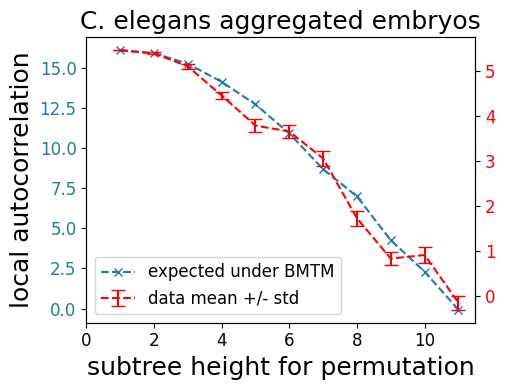

In [26]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos');

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [01:19<00:00,  8.87s/it]


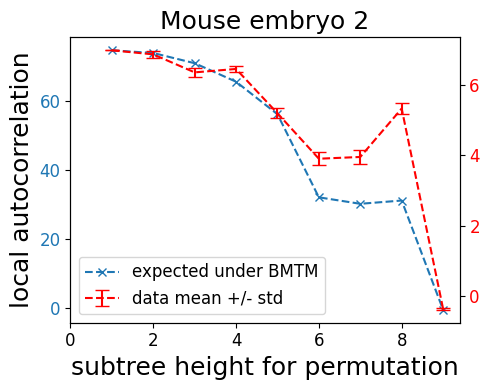

In [28]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2');

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [03:05<00:00, 14.30s/it]


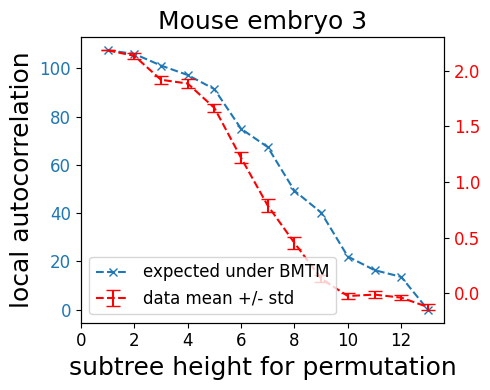

In [29]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3');

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:14<00:00,  1.19it/s]


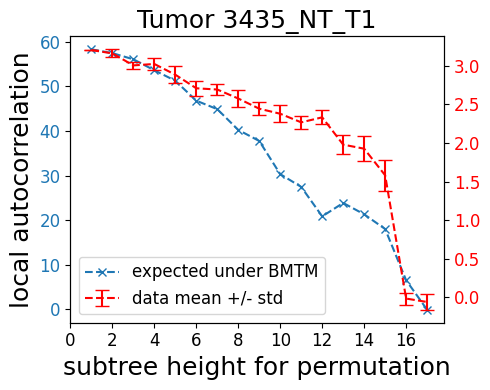

In [30]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1');

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:18<00:00,  1.15it/s]


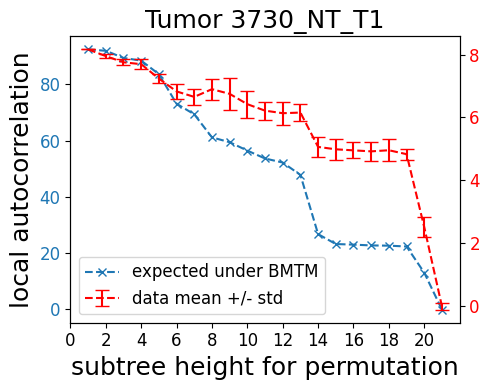

In [31]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1');

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:05<00:00,  2.96it/s]


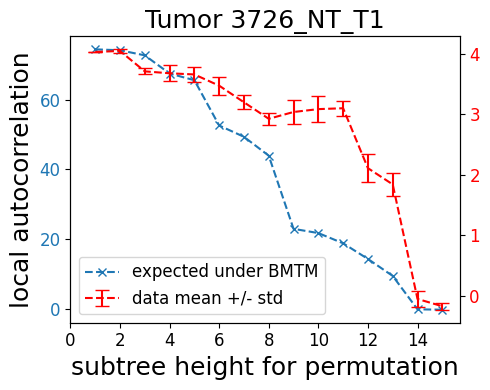

In [32]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1');

# Figure S13

This figure also uses data files create for Fig. 4.

/tmp/ipykernel_3970657/1014834312.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


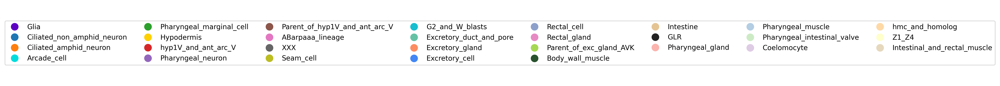

In [34]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

legend_elements = []
for color, cell_type in zip(additional_colors, additional_color_domain):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=8)
fig.tight_layout()

In [40]:
gene_meta = pd.read_csv(f'{data_path}/worm/GSE126954_gene_annotation.csv', index_col='Unnamed: 0')
gene_meta

,id,gene_short_name
WBGene00010957,WBGene00010957,nduo-6
WBGene00010958,WBGene00010958,ndfl-4
WBGene00010959,WBGene00010959,nduo-1
WBGene00010960,WBGene00010960,atp-6
WBGene00010961,WBGene00010961,nduo-2
...,...,...
WBGene00021597,WBGene00021597,spsb-1
WBGene00021596,WBGene00021596,spsb-2
WBGene00021595,WBGene00021595,Y46E12BL.2
WBGene00021594,WBGene00021594,tig-3


## AB subtree

In [36]:
name = 'worm_avg_leaves'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

ab_tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ab_subtree = Tree(ab_tree_path, format=1, quoted_node_names=True)
ab_subtree_labels = ab_subtree.get_leaf_names()
ab_expression = expression.loc[ab_subtree_labels]
ab_norm_expression = norm_expression.loc[ab_subtree_labels]

# load pre-optimization scores
scores_subtree = pd.read_csv(f'{results_path}/scores/worm/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/worm/{name}_scores_remaining.csv', index_col='Unnamed: 0')

### Gene and edge weight optimization

epoch: 1000; score: 153.393382271167326; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 98.90it/s]


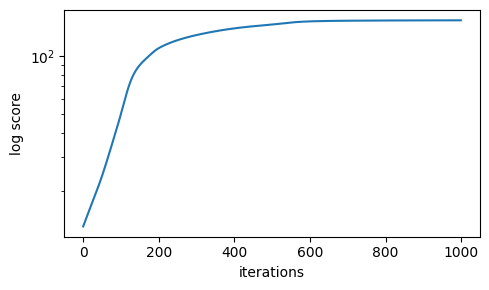

In [37]:
ab_ordered_genes = scores_subtree.drop(columns=['# nodes']).loc['P0A_P0A'].sort_values(ascending=False).index

use_genes = ab_ordered_genes[:1000]
gene_name_str = 'AB_top1000'

model = TreeGeneModel(ab_tree_path, labels_in_order=ab_norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, ab_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                     index=use_genes, columns=['weight'])
loss_fig.show()

gc.collect()
torch.cuda.empty_cache()

ewg_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv')
gw_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv')

### Select genes and GO-terms

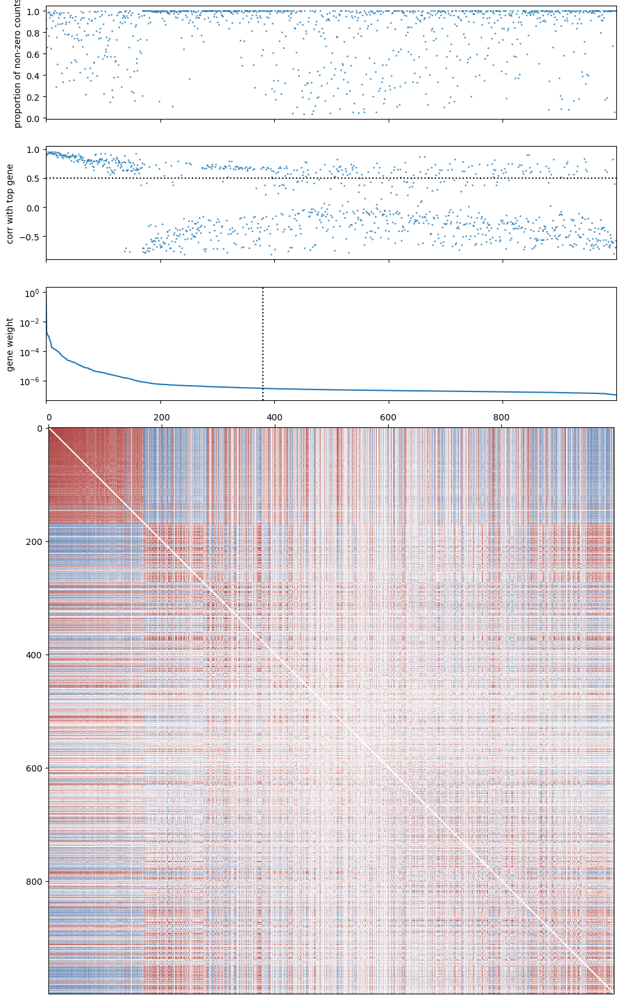

In [38]:
w_ordered_genes = gw_df.sort_values(by='weight', ascending=False).index
fig, (ax0, ax00, ax1, ax2) = plt.subplots(4, 1, figsize=(10, 16), sharex=True, height_ratios=[2, 2, 2, 10])
c = ab_norm_expression[w_ordered_genes].corr()
np.fill_diagonal(c.values, 0) # to not affect range
max_val = np.abs(c.values).max()
np.fill_diagonal(c.values, np.nan)
ax2.imshow(c.values, cmap='vlag', vmin=-max_val, vmax=max_val)
ax0.scatter(np.arange(len(w_ordered_genes)), (ab_expression[w_ordered_genes] > 0).mean().values.flatten(), s=1, alpha=0.7)
ax0.set_ylabel('proportion of non-zero counts')
ax00.scatter(np.arange(len(w_ordered_genes)), c.iloc[0].values.flatten(), s=1, alpha=0.7)
ax00.set_ylabel('corr with top gene')
ax1.plot(gw_df.loc[w_ordered_genes].values.flatten())
ax1.set_yscale('log')
ax1.set_ylabel('gene weight')
ax2.xaxis.tick_top()
idx_cut_off = 380
ax1.axvline(idx_cut_off, ls=':', color='k')
corr_cut_off = 0.5
ax00.axhline(corr_cut_off, ls=':', color='k')
fig.tight_layout()

In [39]:
selected = c.iloc[0].iloc[:idx_cut_off]
selected = selected.index[selected > corr_cut_off]
selected_hypodermis = selected
pd.DataFrame(selected_hypodermis).to_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv', index=False)

In [42]:
gene_name_str = 'AB_top1000'
all_genes = gene_meta.loc[ab_ordered_genes[:1000], 'gene_short_name'].values.tolist()
selected = gene_meta.loc[pd.read_csv(
    f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten(),
                         'gene_short_name'].values.tolist()
print('selected:', len(selected))

enr_all= gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)

enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)
df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv', index=False)
df

selected: 223


,Term,Adjusted P-value,Adjusted P-value using all genes
0,collagen and cuticulin-based cuticle developme...,1.553117e-08,1.645470e-05
1,ribosome assembly (GO:0042255),4.111785e-08,2.280755e-08
2,ribosomal large subunit biogenesis (GO:0042273),9.578421e-08,8.871664e-07
3,translation (GO:0006412),8.437682e-10,2.280755e-08
4,tryptophan catabolic process (GO:0006569),4.269587e-04,2.710913e-02
5,ribosomal large subunit assembly (GO:0000027),3.999180e-07,1.760747e-04
6,cuticle development involved in collagen and c...,1.393366e-08,5.072245e-05
7,peptide biosynthetic process (GO:0043043),8.460166e-07,3.815406e-04
8,cytoplasmic translation (GO:0002181),3.852116e-06,4.801285e-08
9,post-embryonic body morphogenesis (GO:0040032),6.080919e-04,2.379104e-02


### Gene and edge weight optimization after removing top-ranked genes

epoch: 1000; score: 102.115525392006134; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 96.02it/s]


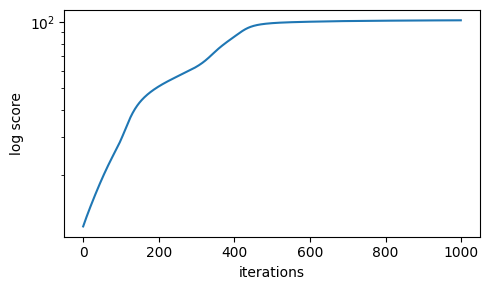

In [44]:
use_genes = ab_ordered_genes[~np.isin(ab_ordered_genes, selected_hypodermis)][:1000]
gene_name_str = 'AB_top1000v2'

model = TreeGeneModel(ab_tree_path, labels_in_order=ab_norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, ab_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                     index=use_genes, columns=['weight'])
loss_fig.show()
gc.collect()
torch.cuda.empty_cache()

ewg_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv')
gw_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv')

### Select genes and GO-terms

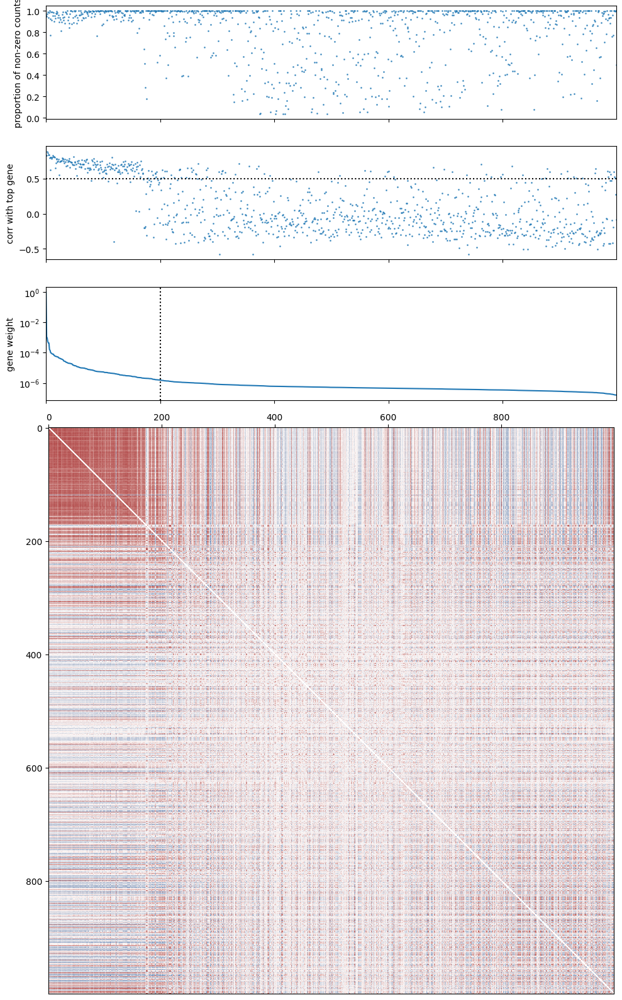

In [45]:
w_ordered_genes = gw_df.sort_values(by='weight', ascending=False).index
fig, (ax0, ax00, ax1, ax2) = plt.subplots(4, 1, figsize=(10, 16), sharex=True, height_ratios=[2, 2, 2, 10])
c = ab_norm_expression[w_ordered_genes].corr()
np.fill_diagonal(c.values, 0) # to not affect range
max_val = np.abs(c.values).max()
np.fill_diagonal(c.values, np.nan)
ax2.imshow(c.values, cmap='vlag', vmin=-max_val, vmax=max_val)
ax0.scatter(np.arange(len(w_ordered_genes)), (ab_expression[w_ordered_genes] > 0).mean().values.flatten(), s=1, alpha=0.7)
ax0.set_ylabel('proportion of non-zero counts')
ax00.scatter(np.arange(len(w_ordered_genes)), c.iloc[0].values.flatten(), s=1, alpha=0.7)
ax00.set_ylabel('corr with top gene')
ax1.plot(gw_df.loc[w_ordered_genes].values.flatten())
ax1.set_yscale('log')
ax1.set_ylabel('gene weight')
ax2.xaxis.tick_top()
idx_cut_off = 200
ax1.axvline(idx_cut_off, ls=':', color='k')
corr_cut_off = 0.5
ax00.axhline(corr_cut_off, ls=':', color='k')
fig.tight_layout()

In [50]:
selected = c.iloc[0].iloc[:idx_cut_off]
selected = selected.index[selected > corr_cut_off]
selected_neuron = selected
pd.DataFrame(selected_neuron).to_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv', index=False)

In [54]:
gene_name_str = 'AB_top1000v2'
all_genes = gene_meta.loc[w_ordered_genes, 'gene_short_name'].values.tolist()
selected = gene_meta.loc[pd.read_csv(
    f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten(),
                         'gene_short_name'].values.tolist()
print('selected:', len(selected))

enr_all= gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv', index=False)
df

selected: 172


,Term,Adjusted P-value,Adjusted P-value using all genes
0,mitotic sister chromatid segregation (GO:0000070),0.000000e+00,1.675000e-13
1,kinetochore assembly (GO:0051382),8.857500e-12,1.212709e-05
2,regulation of protein localization to kinetoch...,8.859876e-08,6.315085e-04
3,sister chromatid segregation (GO:0000819),5.381800e-12,6.739368e-08
4,positive regulation of protein localization to...,8.859876e-08,6.315085e-04
...,...,...,...
169,"anterior/posterior axis specification, embryo ...",2.697576e-02,4.433342e-01
173,vulval development (GO:0040025),1.434236e-02,1.439282e-01
193,ribonucleoprotein complex assembly (GO:0022618),2.688498e-02,1.527486e-03
197,positive regulation of mitotic cell cycle (GO:...,3.281588e-02,4.914584e-01


### Plots for figure

In [58]:
name = 'worm_avg_leaves'
gene_name_str = 'AB_top1000'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

ab_tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ab_subtree = Tree(ab_tree_path, format=1, quoted_node_names=True)
ab_subtree_labels = ab_subtree.get_leaf_names()
ab_expression = expression.loc[ab_subtree_labels]
ab_norm_expression = norm_expression.loc[ab_subtree_labels]

ewg_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv', index_col='Unnamed: 0')
selected_hypodermis = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten()

etree = augment_tree_with_weights(ab_tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P0A_P0A'

etree = augment_tree_with_weights(ab_tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P0A_P0A'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

In [59]:
show_genes = selected_hypodermis[:20]
node_labels = ab_norm_expression.index.values.tolist()
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[ab_norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'], line_width=2,
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [60]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [61]:
labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

/tmp/ipykernel_3970657/2493673592.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[25] = 'erythrose 4-phosphate/phosphoenolpyruvate family amino ... (GO:1902222)'
/tmp/ipykernel_3970657/2493673592.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[28] = 'maturation of SSU-rRNA from tricistronic rRNA transcript ... (GO:0000462)'
/tmp/ipykernel_3970657/2493673592.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

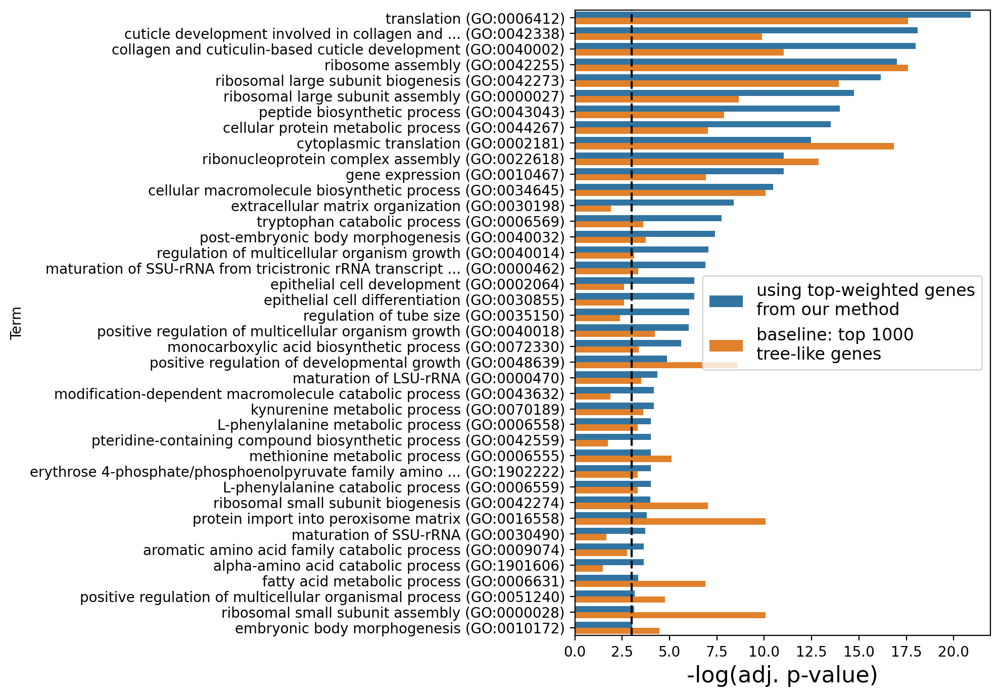

In [62]:
df = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv')
df = df.rename(
    columns={'Adjusted P-value':'selected genes', 'Adjusted P-value using all genes':'all expressed genes'}
)
assert df['Term'].loc[25] == 'erythrose 4-phosphate/phosphoenolpyruvate family amino acid catabolic process (GO:1902222)'
df['Term'].loc[25] = 'erythrose 4-phosphate/phosphoenolpyruvate family amino ... (GO:1902222)'
assert df['Term'].loc[28] == 'maturation of SSU-rRNA from tricistronic rRNA transcript (SSU-rRNA, 5.8S rRNA, LSU-rRNA) (GO:0000462)'
df['Term'].loc[28] = 'maturation of SSU-rRNA from tricistronic rRNA transcript ... (GO:0000462)'
assert df['Term'].loc[6] == 'cuticle development involved in collagen and cuticulin-based cuticle molting cycle (GO:0042338)'
df['Term'].loc[6] = 'cuticle development involved in collagen and ... (GO:0042338)'
df = df.set_index('Term')
df = df.sort_values('selected genes')

mdf = pd.melt((-df[:75].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: top 1000\ntree-like genes'})

fig, ax = plt.subplots(dpi=200, figsize=(10, 7))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

In [63]:
name = 'worm_avg_leaves'
gene_name_str = 'AB_top1000v2'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

ab_tree_path = f'{data_path}/preprocessed/{name}_ab_subtree.nwk'
ab_subtree = Tree(ab_tree_path, format=1, quoted_node_names=True)
ab_subtree_labels = ab_subtree.get_leaf_names()
ab_expression = expression.loc[ab_subtree_labels]
ab_norm_expression = norm_expression.loc[ab_subtree_labels]

ewg_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv', index_col='Unnamed: 0')
selected_hypodermis = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten()

etree = augment_tree_with_weights(ab_tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P0A_P0A'

etree = augment_tree_with_weights(ab_tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P0A_P0A'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

In [64]:
show_genes = selected_hypodermis[:20]
node_labels = ab_norm_expression.index.values.tolist()
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[ab_norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'], line_width=2,
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [65]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [66]:
labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

/tmp/ipykernel_3970657/2765856579.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].iloc[28] = 'RNA splicing, via transesterification reactions ... (GO:0000377)'


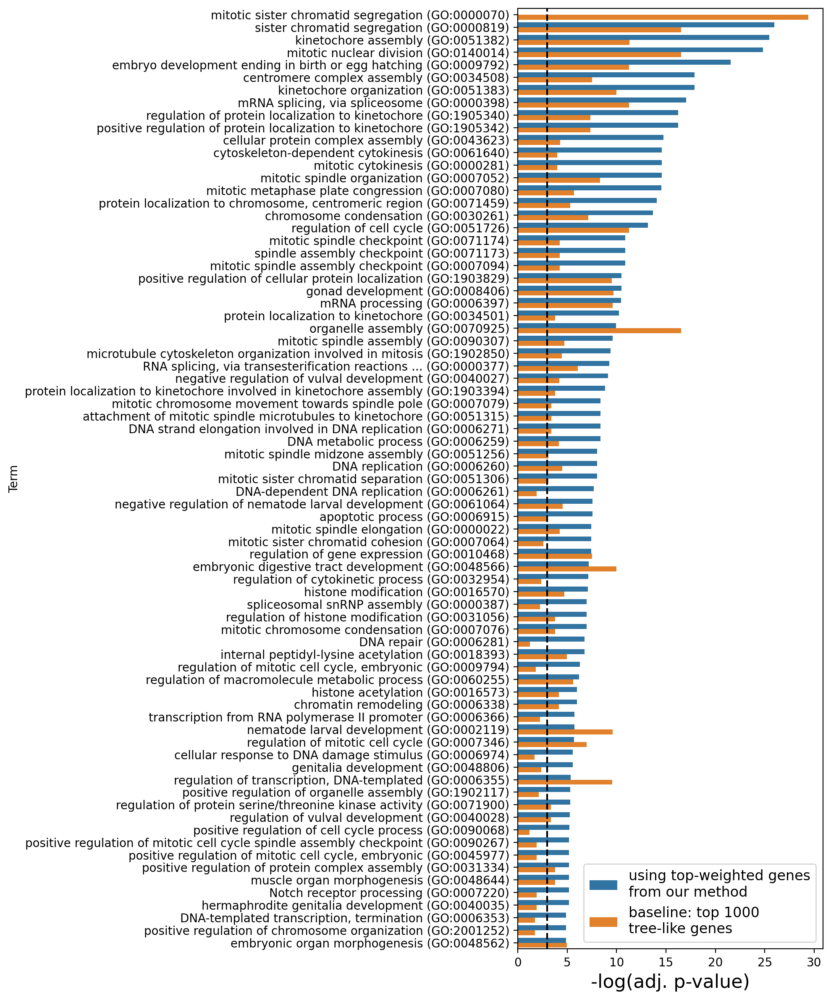

In [67]:
df = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv')
df = df.rename(
    columns={'Adjusted P-value':'selected genes', 'Adjusted P-value using all genes':'all expressed genes'}
)
df = df.sort_values('selected genes')
assert df['Term'].iloc[28] == 'RNA splicing, via transesterification reactions with bulged adenosine as nucleophile (GO:0000377)'
df['Term'].iloc[28] = 'RNA splicing, via transesterification reactions ... (GO:0000377)'
df = df.set_index('Term')

mdf = pd.melt((-df[:75].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: top 1000\ntree-like genes'})

fig, ax = plt.subplots(dpi=200, figsize=(10, 12))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

## Remaining subtree (non-AB)

In [68]:
name = 'worm_avg_leaves'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

other_tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
other_subtree = Tree(other_tree_path, format=1, quoted_node_names=True)
other_subtree_labels = other_subtree.get_leaf_names()
other_expression = expression.loc[other_subtree_labels]
other_norm_expression = norm_expression.loc[other_subtree_labels]

# load pre-optimization scores
scores_subtree = pd.read_csv(f'{results_path}/scores/worm/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/worm/{name}_scores_remaining.csv', index_col='Unnamed: 0')

### Gene and edge weight optimization

epoch: 1000; score: 184.439430032891323; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 98.37it/s]


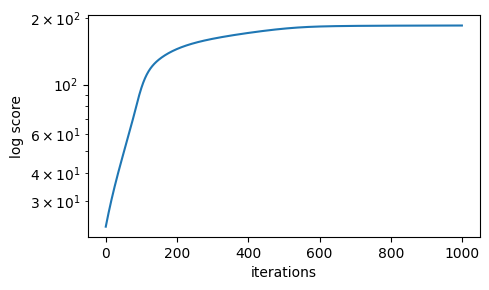

In [69]:
other_ordered_genes = scores_subtree.drop(columns=['# nodes']).loc['P1_P1'].sort_values(ascending=False).index

use_genes = other_ordered_genes[:1000]
gene_name_str = 'nonAB_top1000'

model = TreeGeneModel(other_tree_path, labels_in_order=other_norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, other_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=20)
ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                     index=use_genes, columns=['weight'])
loss_fig.show()

gc.collect()
torch.cuda.empty_cache()

ewg_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv')
gw_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv')

### Select genes and GO-terms

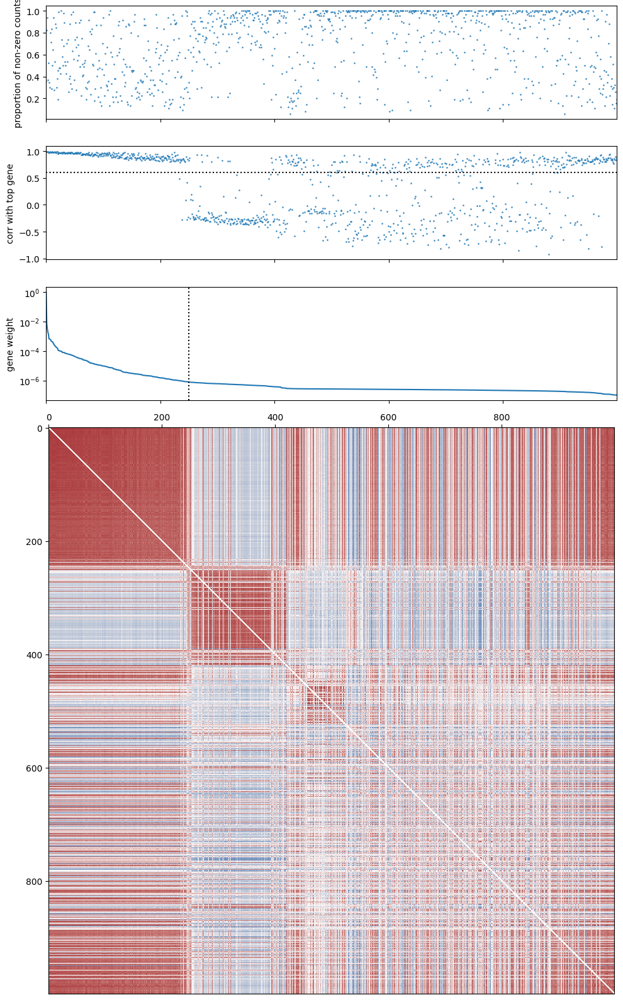

In [70]:
w_ordered_genes = gw_df.sort_values(by='weight', ascending=False).index
fig, (ax0, ax00, ax1, ax2) = plt.subplots(4, 1, figsize=(10, 16), sharex=True, height_ratios=[2, 2, 2, 10])
c = other_norm_expression[w_ordered_genes].corr()
np.fill_diagonal(c.values, 0) # to not affect range
max_val = np.abs(c.values).max()
np.fill_diagonal(c.values, np.nan)
ax2.imshow(c.values, cmap='vlag', vmin=-max_val, vmax=max_val)
ax0.scatter(np.arange(len(w_ordered_genes)), (other_expression[w_ordered_genes] > 0).mean().values.flatten(), s=1, alpha=0.7)
ax0.set_ylabel('proportion of non-zero counts')
ax00.scatter(np.arange(len(w_ordered_genes)), c.iloc[0].values.flatten(), s=1, alpha=0.7)
ax00.set_ylabel('corr with top gene')
ax1.plot(gw_df.loc[w_ordered_genes].values.flatten())
ax1.set_yscale('log')
ax1.set_ylabel('gene weight')
ax2.xaxis.tick_top()
idx_cut_off = 250
ax1.axvline(idx_cut_off, ls=':', color='k')
corr_cut_off = 0.6
ax00.axhline(corr_cut_off, ls=':', color='k')
fig.tight_layout()

In [71]:
selected = c.iloc[0].iloc[:idx_cut_off]
selected = selected.index[selected > corr_cut_off]
selected_intestine = selected
pd.DataFrame(selected_intestine).to_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv', index=False)

In [72]:
gene_name_str = 'nonAB_top1000'
all_genes = gene_meta.loc[other_ordered_genes[:1000], 'gene_short_name'].values.tolist()
selected = gene_meta.loc[pd.read_csv(
    f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten(),
                         'gene_short_name'].values.tolist()
print('selected:', len(selected))

enr_all= gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)

enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)
df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv', index=False)
df

selected: 243


,Term,Adjusted P-value,Adjusted P-value using all genes
0,ocellus pigment biosynthetic process (GO:0008055),0.005978,0.090979
1,eye pigment biosynthetic process (GO:0006726),0.005978,0.090979
2,ommochrome biosynthetic process (GO:0006727),0.005978,0.090979
3,ommochrome metabolic process (GO:0046152),0.005978,0.090979
4,cholesterol efflux (GO:0033344),0.006140,0.111649
5,cellular protein catabolic process (GO:0044257),0.000366,0.016417
6,aromatic compound biosynthetic process (GO:001...,0.007208,0.036066
7,cholesterol transport (GO:0030301),0.009816,0.199862
8,positive regulation of peptidase activity (GO:...,0.010956,0.078973
9,regulation of apoptotic signaling pathway (GO:...,0.010318,0.215786


### Gene and edge weight optimization after removing top-ranked genes

epoch: 1000; score: 174.510626109419547; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 98.76it/s]


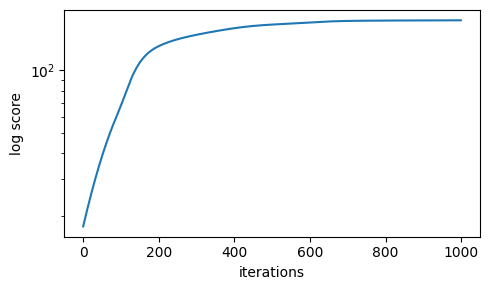

In [73]:
use_genes = other_ordered_genes[~np.isin(other_ordered_genes, selected_intestine)][:1000]
gene_name_str = 'nonAB_top1000v2'

model = TreeGeneModel(other_tree_path, labels_in_order=other_norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                      skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
loss_fig = optimize_weights(model, other_norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:3', gene_group_size=20)
ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                     index=model.edges_ends, columns=['weight'])
ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                     index=use_genes, columns=['weight'])
loss_fig.show()
gc.collect()
torch.cuda.empty_cache()

ewg_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv')
gw_df.to_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv')

### Select genes and GO-terms

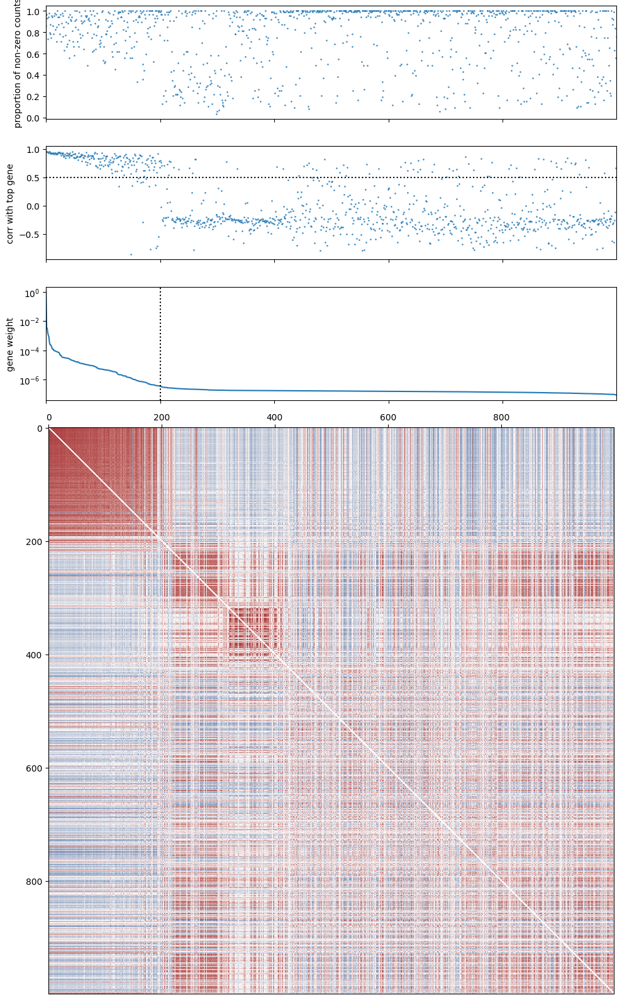

In [74]:
w_ordered_genes = gw_df.sort_values(by='weight', ascending=False).index
fig, (ax0, ax00, ax1, ax2) = plt.subplots(4, 1, figsize=(10, 16), sharex=True, height_ratios=[2, 2, 2, 10])
c = other_norm_expression[w_ordered_genes].corr()
np.fill_diagonal(c.values, 0) # to not affect range
max_val = np.abs(c.values).max()
np.fill_diagonal(c.values, np.nan)
ax2.imshow(c.values, cmap='vlag', vmin=-max_val, vmax=max_val)
ax0.scatter(np.arange(len(w_ordered_genes)), (other_expression[w_ordered_genes] > 0).mean().values.flatten(), s=1, alpha=0.7)
ax0.set_ylabel('proportion of non-zero counts')
ax00.scatter(np.arange(len(w_ordered_genes)), c.iloc[0].values.flatten(), s=1, alpha=0.7)
ax00.set_ylabel('corr with top gene')
ax1.plot(gw_df.loc[w_ordered_genes].values.flatten())
ax1.set_yscale('log')
ax1.set_ylabel('gene weight')
ax2.xaxis.tick_top()
idx_cut_off = 200
ax1.axvline(idx_cut_off, ls=':', color='k')
corr_cut_off = 0.5
ax00.axhline(corr_cut_off, ls=':', color='k')
fig.tight_layout()

In [75]:
selected = c.iloc[0].iloc[:idx_cut_off]
selected = selected.index[selected > corr_cut_off]
selected_bodywall = selected
pd.DataFrame(selected_bodywall).to_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv', index=False)

In [77]:
gene_name_str = 'nonAB_top1000v2'
all_genes = gene_meta.loc[w_ordered_genes, 'gene_short_name'].values.tolist()
selected = gene_meta.loc[pd.read_csv(
    f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten(),
                         'gene_short_name'].values.tolist()
print('selected:', len(selected))

enr_all= gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2018', organism='worm', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv', index=False)
df

selected: 184


,Term,Adjusted P-value,Adjusted P-value using all genes
0,muscle contraction (GO:0006936),2.495542e-09,5.037671e-04
1,regulation of sarcomere organization (GO:0060297),1.269601e-07,3.957783e-05
2,positive regulation of sarcomere organization ...,1.269601e-07,3.957783e-05
3,positive regulation of striated muscle cell di...,1.269601e-07,3.957783e-05
4,positive regulation of cell development (GO:00...,1.269601e-07,3.957783e-05
5,myofibril assembly (GO:0030239),2.262140e-11,2.756305e-07
6,actomyosin structure organization (GO:0031032),5.177620e-09,3.957783e-05
7,heart contraction (GO:0060047),1.951721e-04,4.402929e-02
8,positive regulation of ovulation (GO:0060279),1.826021e-05,1.413040e-03
9,skeletal myofibril assembly (GO:0014866),1.147059e-05,6.878392e-04


### Plots for figure

In [78]:
name = 'worm_avg_leaves'
gene_name_str = 'nonAB_top1000'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

other_tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
other_subtree = Tree(other_tree_path, format=1, quoted_node_names=True)
other_subtree_labels = other_subtree.get_leaf_names()
other_expression = expression.loc[other_subtree_labels]
other_norm_expression = norm_expression.loc[other_subtree_labels]

ewg_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv', index_col='Unnamed: 0')
selected_intestine = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten()

etree = augment_tree_with_weights(other_tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P1_P1'

etree = augment_tree_with_weights(other_tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P1_P1'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

In [79]:
show_genes = selected_intestine[:20]
node_labels = other_norm_expression.index.values.tolist()
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[other_norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'], line_width=2,
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [80]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'], line_width=2,
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [81]:
labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

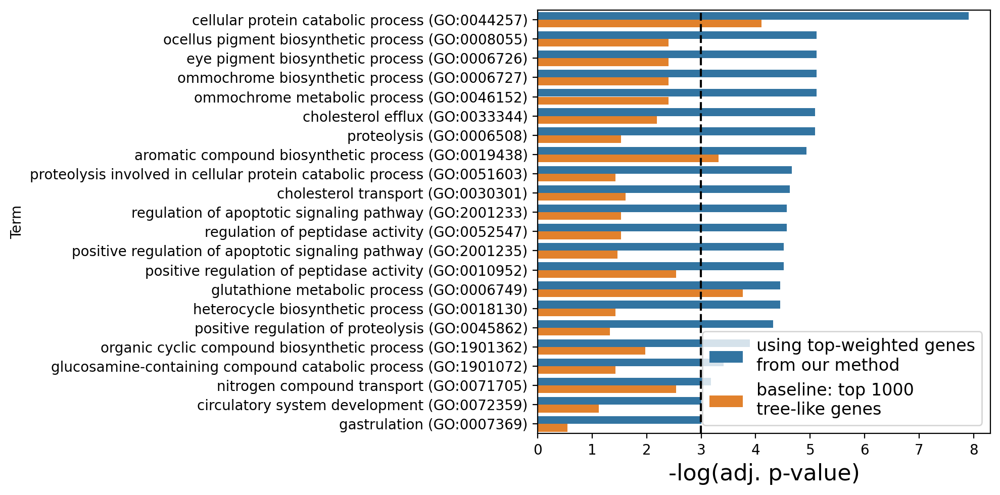

In [82]:
df = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv')
df = df.rename(
    columns={'Adjusted P-value':'selected genes', 'Adjusted P-value using all genes':'all expressed genes'}
)
df = df.set_index('Term')
df = df.sort_values('selected genes')

mdf = pd.melt((-df[:75].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: top 1000\ntree-like genes'})

fig, ax = plt.subplots(dpi=200, figsize=(10, 5))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

In [83]:
name = 'worm_avg_leaves'
gene_name_str = 'nonAB_top1000v2'

# load data
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
expression.index = labels_in_order
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

other_tree_path = f'{data_path}/preprocessed/{name}_other_subtree.nwk'
other_subtree = Tree(other_tree_path, format=1, quoted_node_names=True)
other_subtree_labels = other_subtree.get_leaf_names()
other_expression = expression.loc[other_subtree_labels]
other_norm_expression = norm_expression.loc[other_subtree_labels]

ewg_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/worm/{name}_{gene_name_str}_gw.csv', index_col='Unnamed: 0')
selected_bodywall = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_selected.csv').values.flatten()

etree = augment_tree_with_weights(other_tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'P1_P1'

etree = augment_tree_with_weights(other_tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'P1_P1'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

In [84]:
show_genes = selected_bodywall[:20]
node_labels = other_norm_expression.index.values.tolist()
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[other_norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'], line_width=2,
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [85]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[cell_types.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=additional_colors,
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [86]:
cell_types = pd.read_csv(f'{data_path}/preprocessed/worm_avg_leaves_cell_types.csv', index_col='leaf')
additional_color_domain = cell_types['type'].dropna().unique().tolist()
additional_colors = nice_colors[1:1+len(additional_color_domain)]

labels = nodes[nodes['is_leaf']]['cell_label']
double_tree_plot(nodes, edges, cell_labels=labels,
                 colors=[supp_cell_types_2.loc[labels].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=extra_colors_2,
                 additional_color_domain=extra_color_domain_2, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

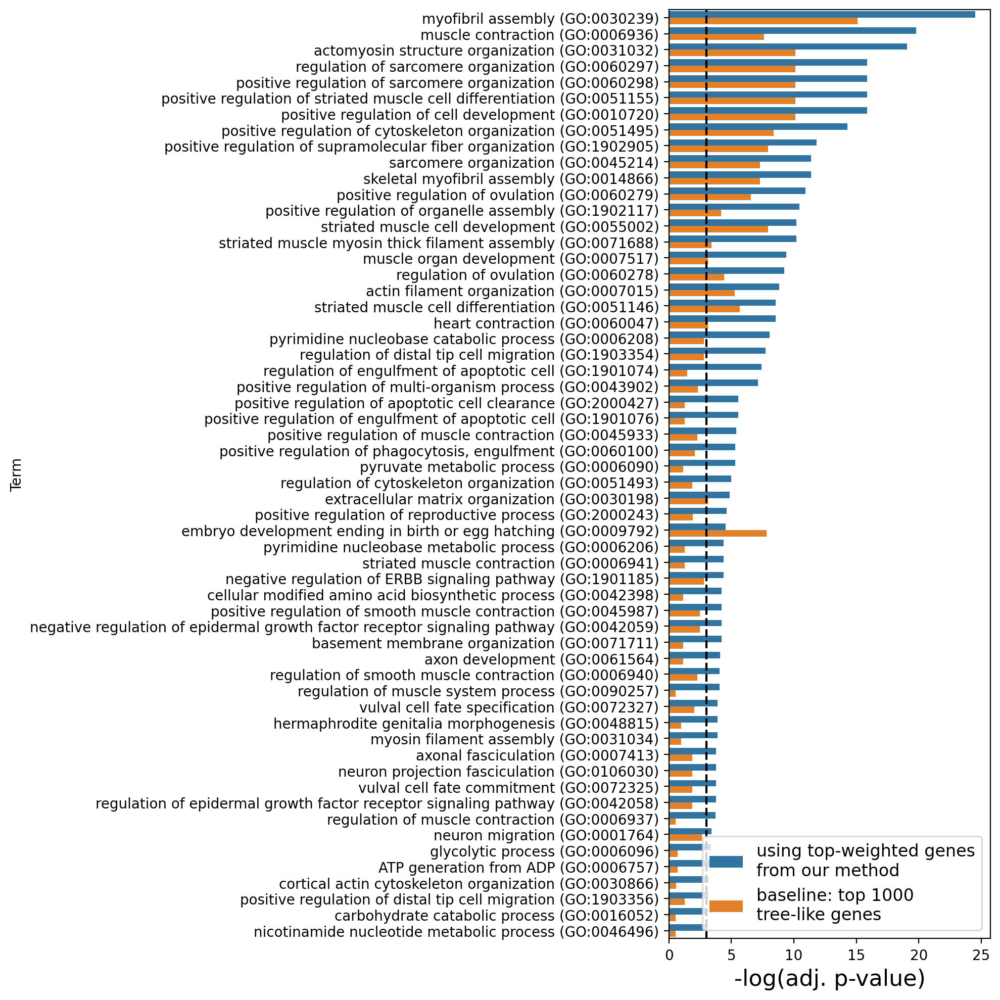

In [87]:
df = pd.read_csv(f'{results_path}/genes/{name}_{gene_name_str}_process_terms.csv')
df = df.rename(
    columns={'Adjusted P-value':'selected genes', 'Adjusted P-value using all genes':'all expressed genes'}
)
df = df.sort_values('selected genes')
df = df.set_index('Term')

mdf = pd.melt((-df[:75].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: top 1000\ntree-like genes'})

fig, ax = plt.subplots(dpi=200, figsize=(10, 10))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

# Figure S15

In [92]:
def load_data(name, seed, n_cells):
  tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'

  # load data
  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  cell_meta = pd.read_csv(f'{data_path}/preprocessed/{name}_cell_types.txt', header=None)
  cell_meta.columns = ['cell_type']
  cell_meta.index = labels_in_order

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  # subsample
  if seed is not None:
    np.random.seed(seed)
    keep_cells = np.random.choice(labels_in_order, size=n_cells, replace=False)
    expression = expression.loc[keep_cells]
    cell_meta = cell_meta.loc[keep_cells]
    labels_in_order = keep_cells

    etree = Tree(tree_path, format=1, quoted_node_names=True)
    print('height before:', etree.get_farthest_leaf()[1])
    print('leaves before:', len(etree.get_leaves()))
    etree.prune(keep_cells.tolist())
    tree_path = f'{data_path}/preprocessed/{name}_pruned_{seed}.nwk'
    etree.write(format=1, outfile=tree_path, quoted_node_names=True)
    print('height after:', etree.get_farthest_leaf()[1])
    print('leaves after:', len(etree.get_leaves()))

  return tree_path, expression, cell_meta, labels_in_order


def reproduce_gw_ew_results(name, seed, n_cells, organism='mouse'):
  tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
  suffix = f'_sub_{seed}' if seed is not None else ''
  np.random.seed(12345)

  # compute scores before optimization
  tree_dists, _ = get_tree_dists(Tree(tree_path, format=1, quoted_node_names=True), labels_in_order)
  gene_scores = get_lac_for_all_genes(tree_dists, expression, gene_group_size=500)
  gene_scores = gene_scores.sort_values('score', ascending=False)
  ordered_genes = gene_scores.index
  gene_scores.to_csv(f'{results_path}/scores/{organism}/{name}_scores{suffix}.csv')

  norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
  use_genes = ordered_genes[:1000]

  # optimize both gene and edge weights
  model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                        skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
  loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:0', gene_group_size=10)
  ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                      index=model.edges_ends, columns=['weight'])
  ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
  gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                      index=use_genes, columns=['weight'])
  loss_fig.show()
  ewg_df.to_csv(f'{results_path}/scores//{organism}/{name}_ewg{suffix}.csv')
  gw_df.to_csv(f'{results_path}/scores//{organism}/{name}_gw{suffix}.csv')

  del model
  gc.collect()
  torch.cuda.empty_cache()

In [89]:
additional_color_domain = [
 'Visceral endoderm late',
 'Primitive blood late',
 'Angioblasts',
 'Visceral endoderm early',
 'Amnion mesoderm early',
 'Parietal endoderm',
 'Similar to neural crest',
 'Somites',
 'Gut endoderm',
 'Future spinal cord',
 'Preplacodal ectoderm',
 'Primitive blood early',
 'Secondary heart field/splanchnic lateral plate',
 'Differentiated trophoblasts',
 'Pharyngeal arch mesoderm',
 'Neural ectoderm anterior',
 'Presomitic mesoderm',
 'Neuromesodermal progenitor late',
 'Posterior lateral plate mesoderm',
 'Fore/midbrain'] + [
 '...',
 'Allantois',
 'Amnion mesoderm late',
 'Distal extraembryonic ectoderm',
 'Hematopoietic/endothelial progenitors',
 'Neural crest',
 'Neural ectoderm posterior',
 'Neuromesodermal progenitor early',
 'Node',
 'Notochord',
 'Primitive blood progenitors',
 'Primitive heart tube',
 'Primitive/definitive endoderm',
 'Primordial germ cells',
 'Splanchnic lateral plate/anterior paraxial mesoderm',
 'Surface ectoderm',
 'Trophoblast stem cells'
 ]

additional_colors = [
  '#5d00c3',
  '#1f77b4',
  '#ff7f0e',
  '#00DCDC',
  '#2ca02c',
  '#FED000',
  '#d62728',
  '#9467bd',
  '#8c564b',
  '#e377c2',
  '#666666',
  '#bcbd22',
  '#c21d64',
  '#66c2a5',
  '#b07200',
  '#010f69',
  '#f620fa',
  '#bdfcc5',
  '#aeccfc',
  '#e5c494'] + 17 * ['#000000']

/tmp/ipykernel_3970657/1621671325.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


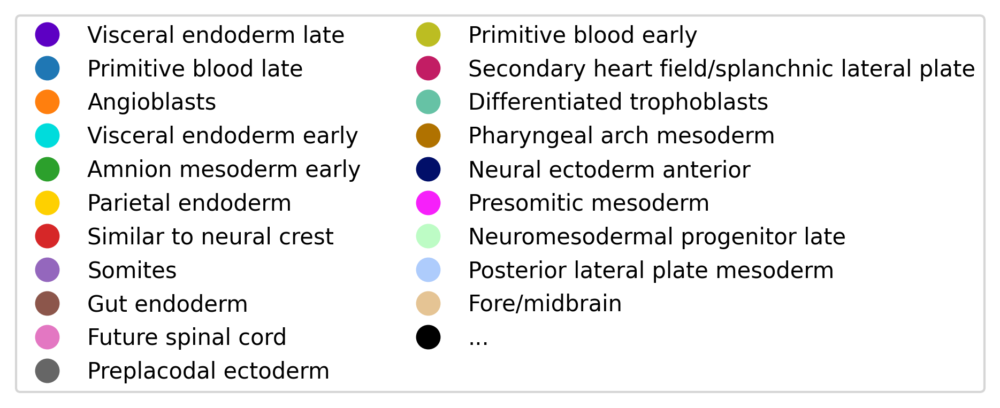

In [90]:
from matplotlib.lines import Line2D

color_df = pd.DataFrame(index=additional_color_domain[:-16])
color_df['color'] = additional_colors[:-16]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=2)
fig.tight_layout()

## Embryo 2

### Optimize gene and edge weights

height before: 9.0
leaves before: 1399
height after: 9.0
leaves after: 1000


epoch: 1000; score: 450.551704125096649; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:24<00:00,  6.93it/s]


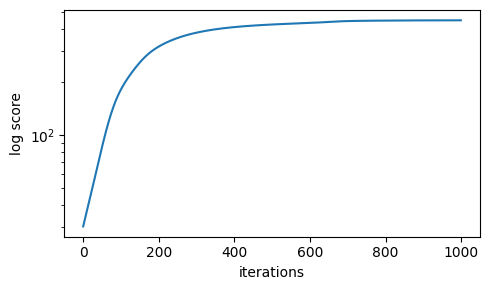

In [93]:
name = 'GSE117542_embryo2'
seed = 82712
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 9.0
leaves before: 1399
height after: 9.0
leaves after: 1000


epoch: 1000; score: 456.758529867384709; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:25<00:00,  6.89it/s]


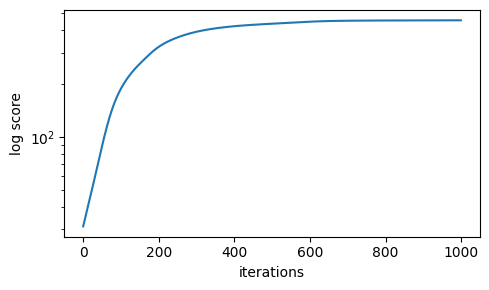

In [94]:
name = 'GSE117542_embryo2'
seed = 29873
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000


epoch: 1000; score: 452.545925224756616; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:25<00:00,  6.88it/s]


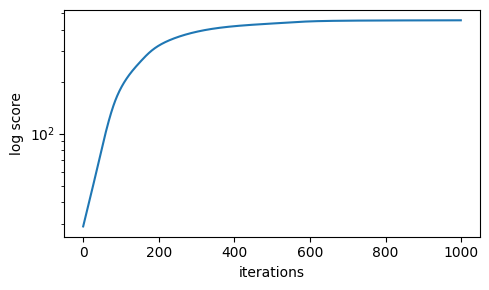

In [95]:
name = 'GSE117542_embryo2'
seed = 52382
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000


epoch: 1000; score: 455.292572741109723; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:25<00:00,  6.88it/s]


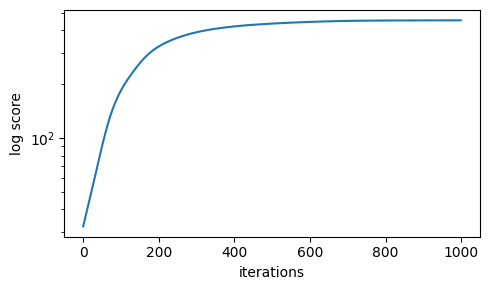

In [96]:
name = 'GSE117542_embryo2'
seed = 19442
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000


epoch: 1000; score: 464.988038720402528; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:24<00:00,  6.90it/s]


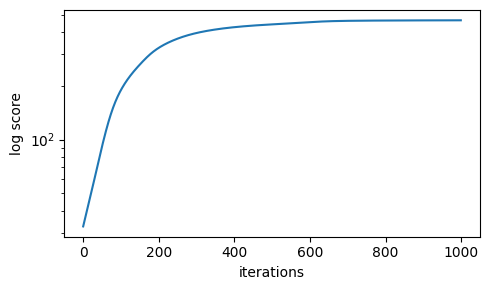

In [97]:
name = 'GSE117542_embryo2'
seed = 79815
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Select genes

height before: 9.0
leaves before: 1399
height after: 9.0
leaves after: 1000
not selected but\nscore significant    689
selected                               311
Name: color, dtype: int64


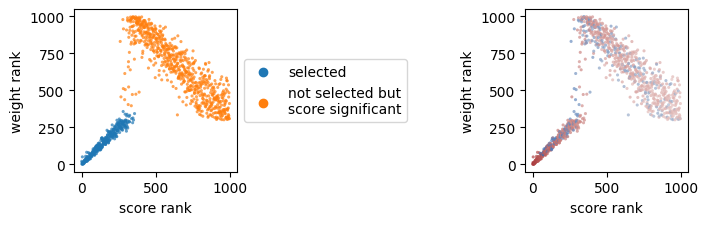

In [98]:
name = 'GSE117542_embryo2'
seed = 82712
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 400) & (gene_rank_df['weight rank'] < 360), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 9.0
leaves before: 1399
height after: 9.0
leaves after: 1000
not selected but\nscore significant    687
selected                               313
Name: color, dtype: int64


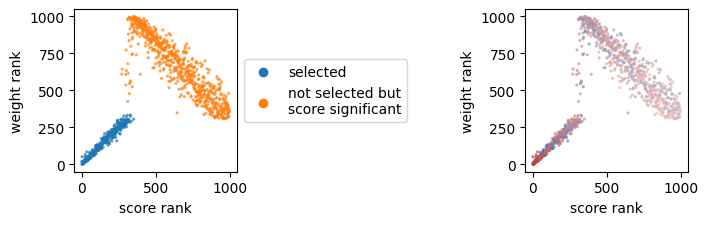

In [99]:
name = 'GSE117542_embryo2'
seed = 29873
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 380) & (gene_rank_df['weight rank'] < 357), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000
not selected but\nscore significant    692
selected                               308
Name: color, dtype: int64


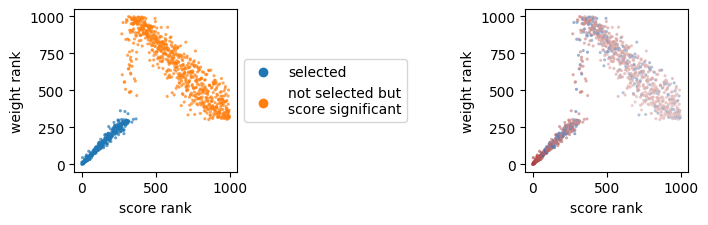

In [100]:
name = 'GSE117542_embryo2'
seed = 52382
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 400) & (gene_rank_df['weight rank'] < 400), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000
not selected but\nscore significant    685
selected                               315
Name: color, dtype: int64


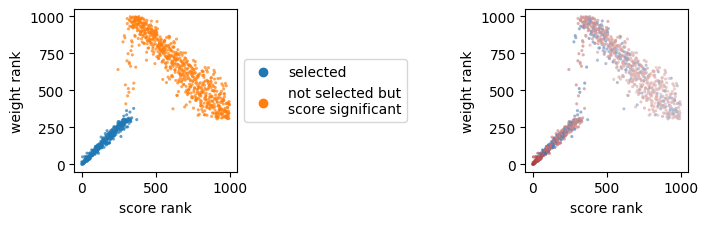

In [101]:
name = 'GSE117542_embryo2'
seed = 19442
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 380) & (gene_rank_df['weight rank'] < 400), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 9.0
leaves before: 1399
height after: 8.0
leaves after: 1000
not selected but\nscore significant    689
selected                               311
Name: color, dtype: int64


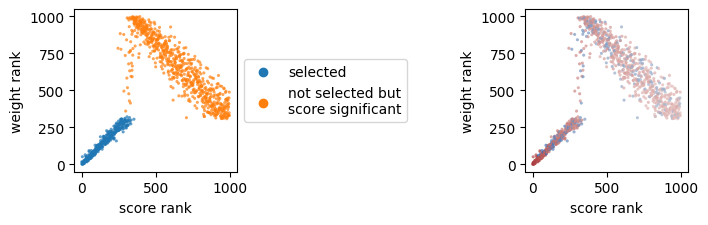

In [102]:
name = 'GSE117542_embryo2'
seed = 79815
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 380) & (gene_rank_df['weight rank'] < 350), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [105]:
# match with GO terms from GO_Biological_Process_2023
name = 'GSE117542_embryo2'
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')

array(['Ubiquitin-Dependent Protein Catabolic Process (GO:0006511)',
       'Proteasome-Mediated Ubiquitin-Dependent Protein Catabolic Process (GO:0043161)',
       'Gene Expression (GO:0010467)',
       'Positive Regulation Of DNA-templated Transcription (GO:0045893)',
       'mRNA Splicing, Via Spliceosome (GO:0000398)',
       'mRNA Processing (GO:0006397)',
       'Intracellular Protein Transport (GO:0006886)',
       'Translation (GO:0006412)', 'DNA Metabolic Process (GO:0006259)',
       'Protein Modification Process (GO:0036211)',
       'RNA Splicing, Via Transesterification Reactions With Bulged Adenosine As Nucleophile (GO:0000377)',
       'RNA Processing (GO:0006396)',
       'Golgi Vesicle Transport (GO:0048193)', 'DNA Repair (GO:0006281)',
       'Proteasomal Protein Catabolic Process (GO:0010498)',
       'Positive Regulation Of Transcription By RNA Polymerase II (GO:0045944)',
       'Mitochondrial Translation (GO:0032543)',
       'Mitochondrial Gene Expression (GO:014

### Plots for figure

In [106]:
name = 'GSE117542_embryo2'
seed = 82712
n_cells = 1000

gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = norm_expression.index
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'],
                 show_legend=True, continuous_colors=True, width=575)

height before: 9.0
leaves before: 1399
height after: 9.0
leaves after: 1000


alt.HConcatChart(...)

In [107]:
show_genes = list(gw_df.sort_values('weight', ascending=False).index[20:40])
node_labels = norm_expression.index
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [108]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

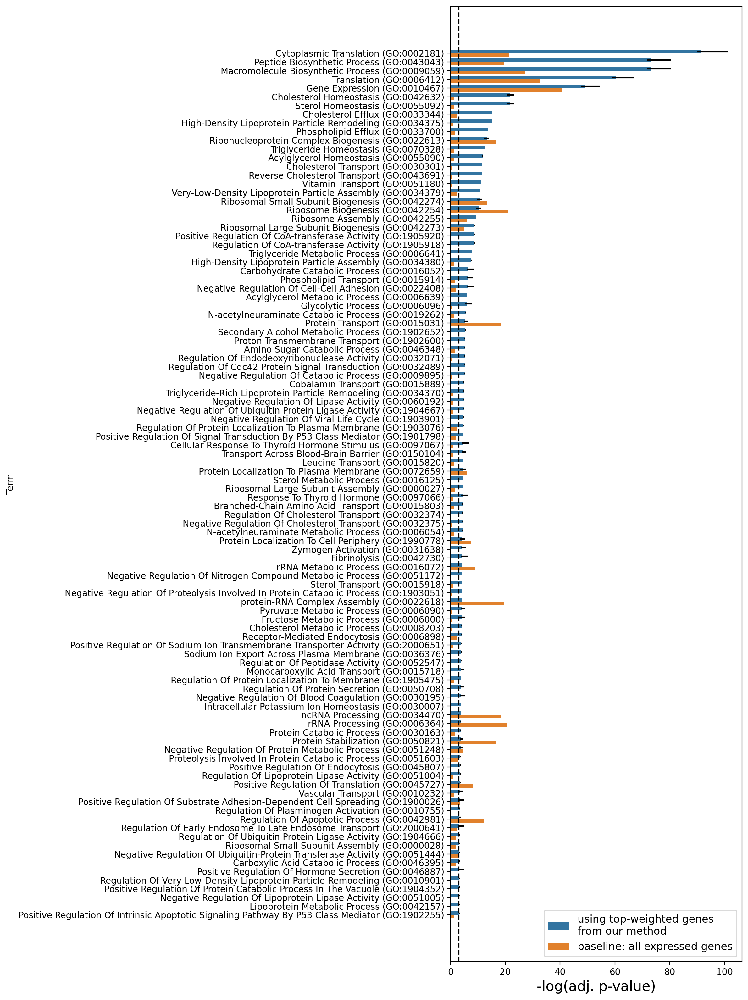

In [109]:
name = 'GSE117542_embryo2'

df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df[:100].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.loc[0:m-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:m-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:m-1, 'low'] -= (-df[:m][df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:m-1, 'up'] += (-df[:m][df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all expressed genes'})

fig, ax = plt.subplots(dpi=200, figsize=(12, 16))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

## Embryo 3

### Optimize gene and edge weights

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000


epoch: 1000; score: 254.580648813933209; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:34<00:00,  6.48it/s]


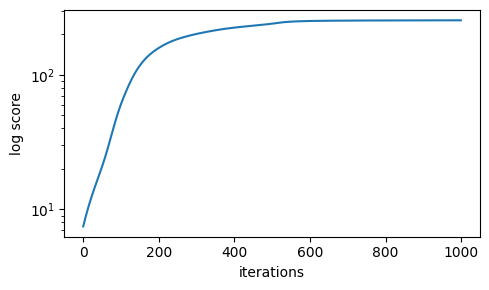

In [110]:
name = 'GSM3302829_embryo3'
seed = 82712
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000


epoch: 1000; score: 293.048079070101437; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:33<00:00,  6.51it/s]


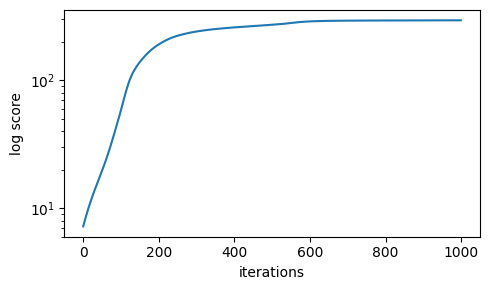

In [111]:
name = 'GSM3302829_embryo3'
seed = 29873
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000


epoch: 1000; score: 265.820021711646973; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:34<00:00,  6.49it/s]


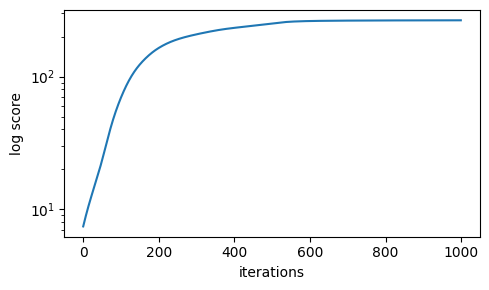

In [112]:
name = 'GSM3302829_embryo3'
seed = 52382
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000


epoch: 1000; score: 273.255386983158076; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:33<00:00,  6.49it/s]


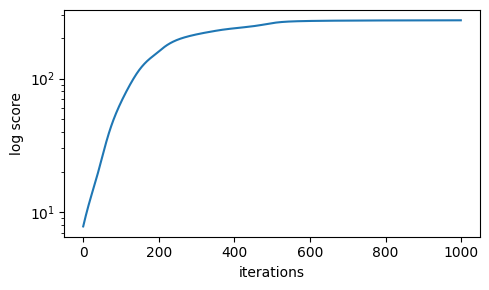

In [113]:
name = 'GSM3302829_embryo3'
seed = 19442
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

height before: 13.0
leaves before: 1756
height after: 12.0
leaves after: 1000


epoch: 1000; score: 239.589771754601713; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:34<00:00,  6.47it/s]


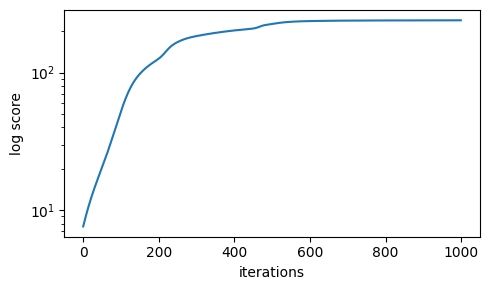

In [114]:
name = 'GSM3302829_embryo3'
seed = 79815
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Select genes

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000
not selected but\nscore significant    737
selected                               263
Name: color, dtype: int64


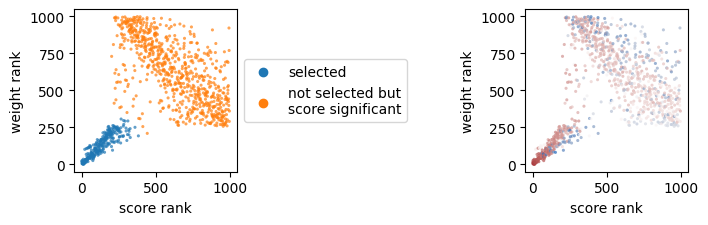

In [115]:
name = 'GSM3302829_embryo3'
seed = 82712
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 400) & (gene_rank_df['weight rank'] < 307), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000
not selected but\nscore significant    746
selected                               254
Name: color, dtype: int64


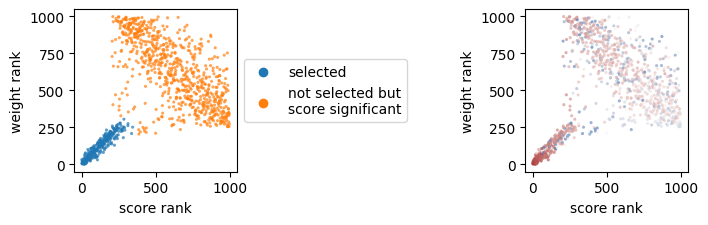

In [116]:
name = 'GSM3302829_embryo3'
seed = 29873
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 380) & (gene_rank_df['weight rank'] < 307), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000
not selected but\nscore significant    702
selected                               298
Name: color, dtype: int64


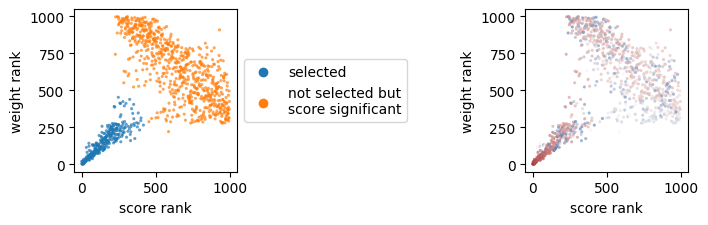

In [117]:
name = 'GSM3302829_embryo3'
seed = 52382
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 450) & (gene_rank_df['weight rank'] < 500), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000
not selected but\nscore significant    730
selected                               270
Name: color, dtype: int64


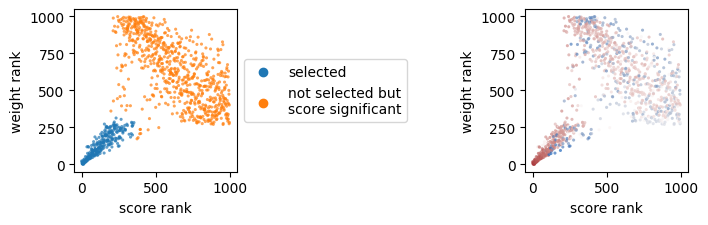

In [118]:
name = 'GSM3302829_embryo3'
seed = 19442
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 360) & (gene_rank_df['weight rank'] < 330), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

height before: 13.0
leaves before: 1756
height after: 12.0
leaves after: 1000
not selected but\nscore significant    730
selected                               270
Name: color, dtype: int64


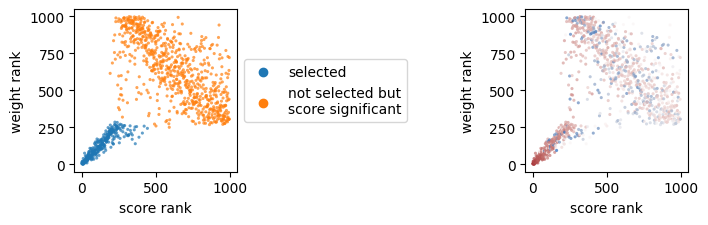

In [119]:
name = 'GSM3302829_embryo3'
seed = 79815
n_cells = 1000

# Rank comparison to select genes
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/mouse/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values[:1000]

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 450) & (gene_rank_df['weight rank'] < 300), 'color'] = 'agree'

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [121]:
# match with GO terms from GO_Biological_Process_2023
name = 'GSM3302829_embryo3'
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')

array(['Gene Expression (GO:0010467)',
       'Ubiquitin-Dependent Protein Catabolic Process (GO:0006511)',
       'mRNA Splicing, Via Spliceosome (GO:0000398)',
       'Proteasome-Mediated Ubiquitin-Dependent Protein Catabolic Process (GO:0043161)',
       'Positive Regulation Of DNA-templated Transcription (GO:0045893)',
       'mRNA Processing (GO:0006397)',
       'Protein Modification Process (GO:0036211)',
       'Translation (GO:0006412)',
       'RNA Splicing, Via Transesterification Reactions With Bulged Adenosine As Nucleophile (GO:0000377)',
       'RNA Processing (GO:0006396)',
       'DNA Metabolic Process (GO:0006259)', 'DNA Repair (GO:0006281)',
       'Intracellular Protein Transport (GO:0006886)',
       'Golgi Vesicle Transport (GO:0048193)',
       'DNA Damage Response (GO:0006974)',
       'Positive Regulation Of Nucleic Acid-Templated Transcription (GO:1903508)',
       'Mitochondrial Translation (GO:0032543)',
       'Proteasomal Protein Catabolic Process (GO:0010

### Plots for figure

In [122]:
name = 'GSM3302829_embryo3'
seed = 82712
n_cells = 1000

gw_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/mouse/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = norm_expression.index
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'],
                 show_legend=True, continuous_colors=True, width=575)

height before: 13.0
leaves before: 1756
height after: 13.0
leaves after: 1000


alt.HConcatChart(...)

In [123]:
show_genes = list(gw_df.sort_values('weight', ascending=False).index[20:40])
node_labels = norm_expression.index
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[norm_expression[gene] for gene in show_genes],
                 color_names=[f'{gene} expression' for gene in show_genes],
                 tooltip_names=['cell_label'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [124]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten()],
                 color_names=['cell_type'],
                 tooltip_names=['cell_label', 'cell_type'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

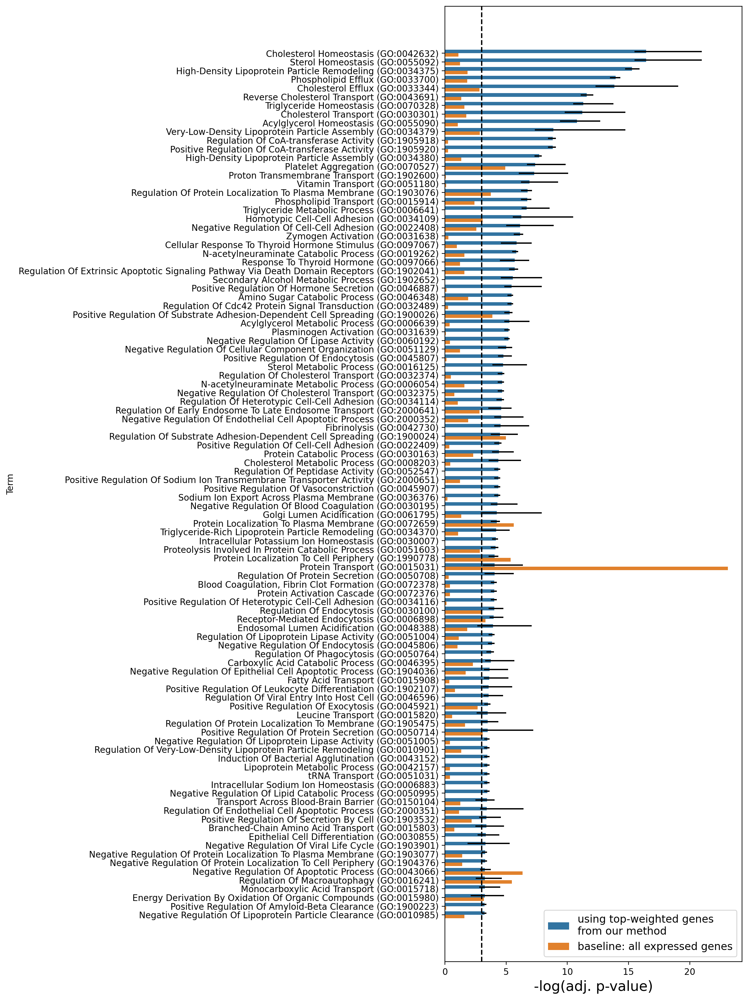

In [125]:
name = 'GSM3302829_embryo3'

df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df[:100].apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
m = 100 #len(df)
mdf.loc[0:m-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:m-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:m-1, 'low'] -= (-df[:m][df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:m-1, 'up'] += (-df[:m][df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all expressed genes'})

fig, ax = plt.subplots(dpi=200, figsize=(12, 16))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')
fig.tight_layout()

# Figure S17

In [128]:
def load_data(name):
  tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'

  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  cell_types = pd.read_csv(f'{data_path}/preprocessed/{name}_cell_types.txt', header=None)
  cell_types.columns = ['type']
  cell_types.index = labels_in_order
  cv = cell_types.value_counts()
  main_types = ['All'] + [t[0] for t in cv.index[:4]]

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  return tree_path, labels_in_order, cell_types, main_types, expression


def reproduce_data_for_plots(name):
  tree_path, labels_in_order, cell_types, main_types, expression = load_data(name)
  etree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', quoted_node_names=True, format=1)
  aggs = {}
  expected_lacs = {}
  for t in main_types:
    subtree_labels = cell_types[cell_types['type'] == t].index.values if t != 'All' else None
    expected_lacs[t] = get_expected_lac_bmtm_height_perm(etree, expression.index, labels_subset=subtree_labels)
    aggs[t] = get_perm_dists(expression, tree_path=tree_path, subtree_labels=subtree_labels)

  with open(f'{results_path}/scores/tumor/{name}_expected_lac.pk', 'wb') as handle:
    pickle.dump(expected_lacs, handle)
  with open(f'{results_path}/scores/tumor/{name}_real_lac.pk', 'wb') as handle:
    pickle.dump(aggs, handle)


def make_plots(name):
  tree_path, labels_in_order, cell_types, main_types, expression = load_data(name)

  # make legend
  color_df = pd.DataFrame(index=kp_color_domain)
  color_df['color'] = nice_colors
  color_df = color_df.loc[cell_types['type'].value_counts().index]
  legend_elements = []
  for color, cell_type in zip(color_df['color'], color_df.index):
    legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

  fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
  ax.axis('off')
  ax.legend(handles=legend_elements, loc='center', ncol=1)
  fig.tight_layout()
  fig.show()

  # print cell type stats
  cv = cell_types.value_counts()
  print('# of cells:', len(cell_types))
  print(cv)

  with open(f'{results_path}/scores/tumor/{name}_expected_lac.pk', 'rb') as handle:
    expected_lacs = pickle.load(handle)
  with open(f'{results_path}/scores/tumor/{name}_real_lac.pk', 'rb') as handle:
    aggs = pickle.load(handle)

  # plot scores
  color_df.loc['All', 'color'] = '#000000'
  dist_id = 'la'
  fig, axxs = plt.subplots(2, 5, figsize=(25, 8))
  for i, t in enumerate(main_types):
    agg = aggs[t]
    expected_lac = expected_lacs[t]
    axs = axxs.T[i]

    ax2 = axs[0]
    ax2.errorbar(agg.index, agg[f'{dist_id}_expression_mean'], yerr=agg[f'{dist_id}_expression_std'],
                label=f'{t}', color=color_df.loc[t, 'color'], fmt='--', capsize=5)
    ax2.set_xlabel('subtree height for permutation', fontsize=18)
    ax2.tick_params(axis='both', which='major', labelsize=12)
    ax2.set_title(f'real data', fontsize=18)

    a = (agg[f'{dist_id}_expression_mean'] - agg[f'{dist_id}_expression_std']).min()
    b = (agg[f'{dist_id}_expression_mean'] + agg[f'{dist_id}_expression_std']).max()
    ax2.set_ylim(a - 0.05 * (b - a), b + 0.05 * (b - a))
    ax2.set_xticks(agg.index.values[::4].tolist())

    ax = axs[1]
    ax.plot(expected_lac['height'], expected_lac['lac'], 'x--', color=color_df.loc[t, 'color'])
    ax.set_xlabel('subtree height for permutation', fontsize=18)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_title(f'expected under BMTM', fontsize=18)
    ax.set_xticks(axs[0].get_xticks())

  fig.tight_layout()
  fig.subplots_adjust(hspace=0.4)

  # plot tree
  node_data, edge_data = get_node_and_edge_data(tree_path)
  return single_tree_plot(node_data, edge_data, cell_labels=labels_in_order,
                   colors=[cell_types.loc[labels_in_order].values.flatten().tolist()],
                   color_names=['cell_type'], tooltip_names=['cell_label', 'cell_type'],
                   show_legend=False, continuous_colors=False)

## Tumor 3726_NT_T2

In [129]:
reproduce_data_for_plots('3726_NT_T2')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 16.85it/s]


# of cells: 853
type           
AT2-like           755
AT1-like            58
Early gastric       18
High plasticity     11
Early EMT-1          5
Gastric-like         5
Pre-EMT              1
dtype: int64


alt.LayerChart(...)

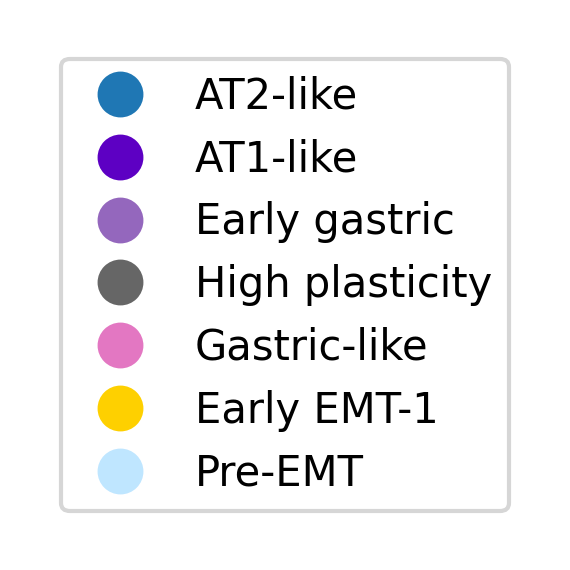

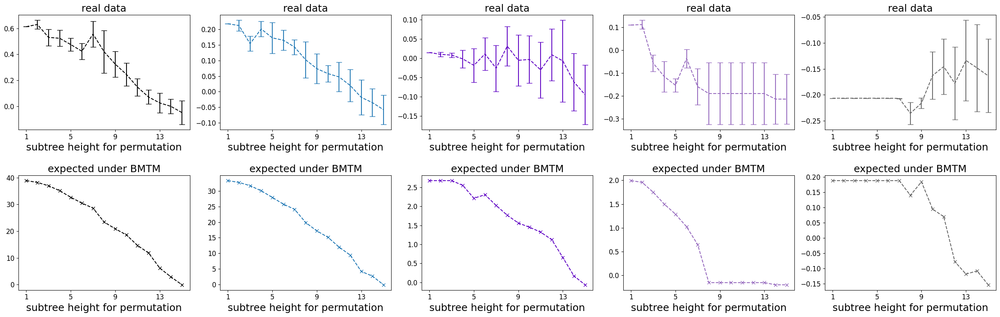

In [130]:
make_plots('3726_NT_T2')

## Tumor 3730_NT_T1

In [131]:
reproduce_data_for_plots('3730_NT_T1')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:03<00:00,  5.26it/s]


# of cells: 1218
type                
Lung progenitor-like    567
AT2-like                515
AT1-like                 60
High plasticity          37
Endoderm-like            11
Pre-EMT                  11
Early EMT-2               6
Gastric-like              6
Early gastric             3
Early EMT-1               1
Mesenchymal-1             1
dtype: int64


alt.LayerChart(...)

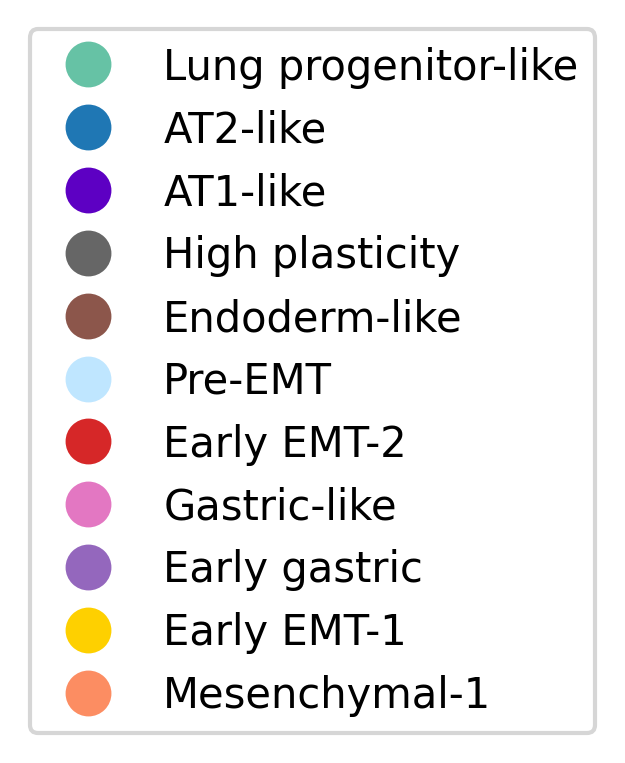

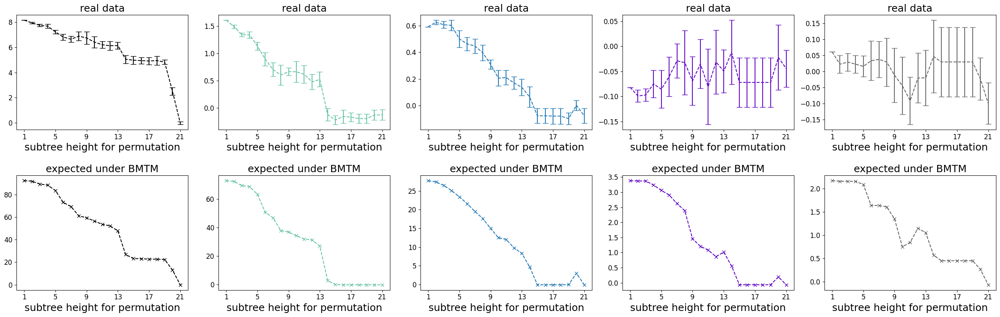

In [132]:
make_plots('3730_NT_T1')

## Tumor 3513_NT_T4

In [133]:
reproduce_data_for_plots('3513_NT_T4')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:01<00:00,  8.67it/s]


# of cells: 604
type           
High plasticity    204
Gastric-like       150
Early EMT-1        133
AT1-like            56
Pre-EMT             28
AT2-like            24
Endoderm-like        7
Early gastric        2
dtype: int64


alt.LayerChart(...)

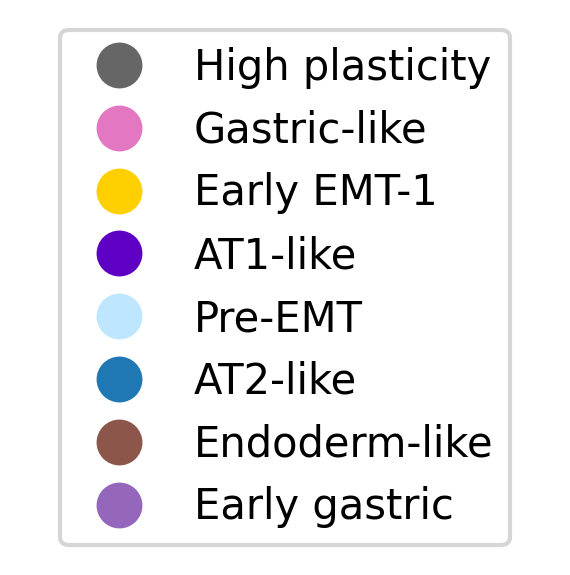

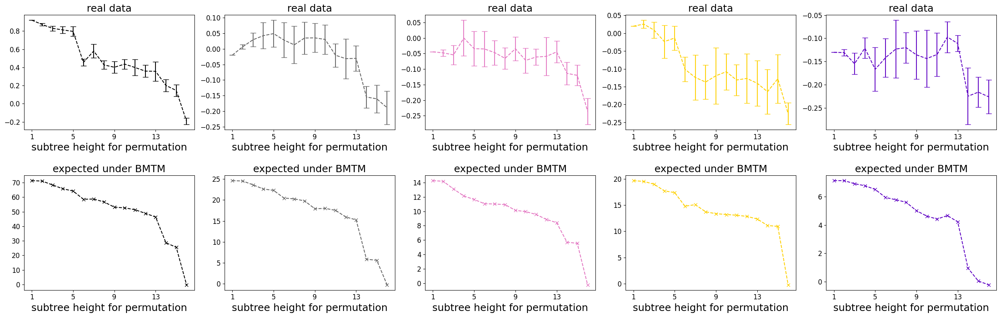

In [134]:
make_plots('3513_NT_T4')

## Tumor 3726_NT_T1

In [135]:
reproduce_data_for_plots('3726_NT_T1')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:02<00:00,  7.40it/s]


# of cells: 753
type                
Early EMT-1             333
Pre-EMT                 143
AT2-like                103
Lung progenitor-like     69
High plasticity          31
Gastric-like             29
Endoderm-like            20
AT1-like                 13
Mesenchymal-2             7
Early EMT-2               4
Mesenchymal-1             1
dtype: int64


alt.LayerChart(...)

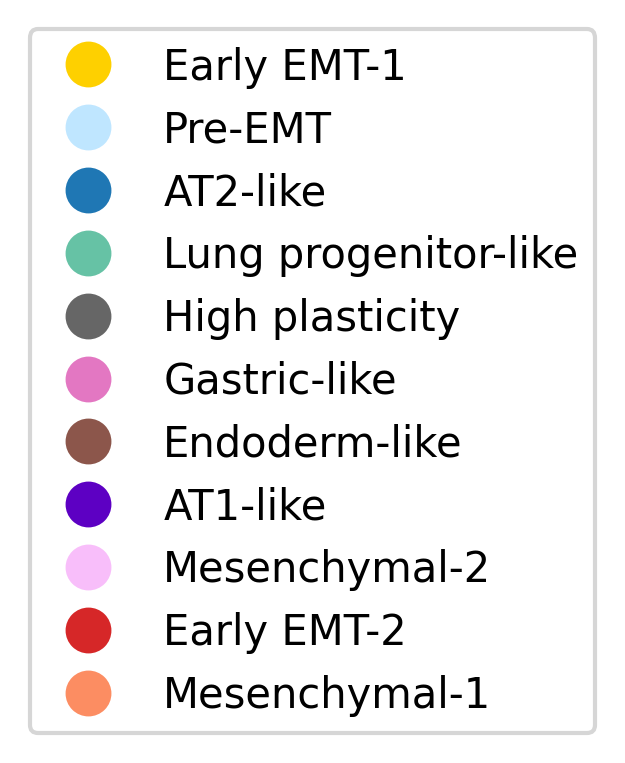

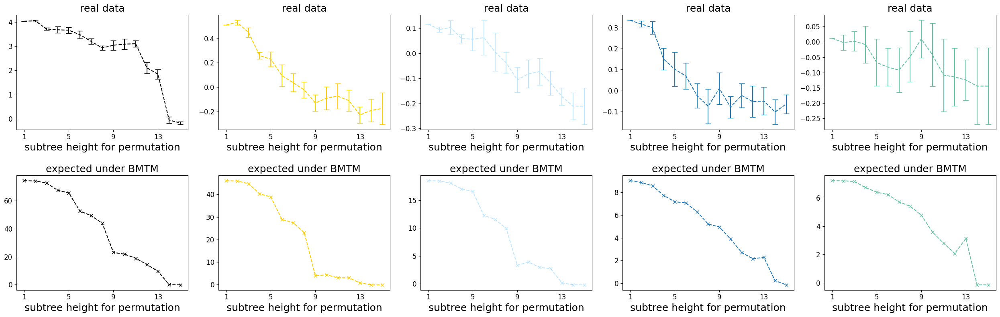

In [136]:
make_plots('3726_NT_T1')

# Figure S8

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:32<00:00,  3.22s/it]


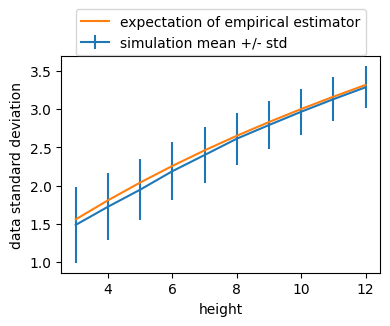

In [137]:
ds = np.arange(3, 13)
sim_std_mean = np.zeros(len(ds))
sim_std_std = np.zeros(len(ds))
theo_std = np.zeros(len(ds))
theo_emp_std = np.zeros(len(ds))
for i, d in enumerate(tqdm(ds)):
  tree = Tree(make_binary_tree(height=d), format=1)
  expression_df = generate_bmtm_data_from_tree(tree, 100, sigma=1)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)
  sim_stds = np.std(expression_df.values, axis=0, ddof=1)
  sim_std_mean[i], sim_std_std[i] = np.mean(sim_stds), np.std(sim_stds, ddof=1)
  theo_std[i] = np.sqrt(np.mean(np.diag(mrca_depths)))
  N = len(mrca_depths)
  theo_emp_std[i] = np.sqrt(np.sum(np.diag(mrca_depths)) /( N-1) - 1/(N*(N-1)) * np.sum(mrca_depths))

fig, ax = plt.subplots(figsize=(4, 3.5))
ax.errorbar(ds, sim_std_mean, yerr=sim_std_std, label='simulation mean +/- std')
ax.plot(ds, theo_emp_std, label='expectation of empirical estimator')
ax.set_xlabel('height')
ax.set_ylabel('data standard deviation')
ax.legend(bbox_to_anchor=(0.5, 1.25), loc='upper center')
fig.tight_layout()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:49<00:00,  5.00s/it]


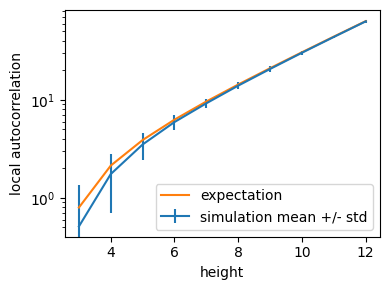

In [138]:
ds = np.arange(3, 13)
emp_mean = np.zeros(len(ds))
emp_std = np.zeros(len(ds))
theo = np.zeros(len(ds))
for i, d in enumerate(tqdm(ds)):
  tree = Tree(make_binary_tree(height=d), format=1)
  expression_df = generate_bmtm_data_from_tree(tree, 100, sigma=1)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)
  emp_mean[i], emp_std[i] = lac_empirical(tree_dists, expression_df.values)
  theo[i] = lac_theoretical(mrca_depths, tree_dists)

fig, ax = plt.subplots(figsize=(4, 3))
ax.errorbar(ds, emp_mean, yerr=emp_std, label='simulation mean +/- std')
ax.plot(ds, theo, label='expectation')
ax.set_xlabel('height')
ax.set_ylabel('local autocorrelation')
ax.set_yscale('log')
ax.legend()
fig.tight_layout()

In [139]:
def compute_sim_scores(tree, gamma=10):
  _, d = tree.get_farthest_leaf()
  d = int(d)
  expression_df = generate_bmtm_data_from_tree(tree, 100, sigma=1)
  N = len(expression_df)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)
  np.random.seed(123121)
  theo_perm_lac = np.zeros(d)
  sim_perm_lac_mean = np.zeros(d)
  sim_perm_lac_std = np.zeros(d)
  for j, perm_d in enumerate(range(1, d+1)):
    subsets = extract_subsets_with_height(
        tree, height=perm_d, include_labels=expression_df.index, return_ids=True)
    expression = expression_df.values + 0
    for i in range(100):
      perm_ids = get_permutation_ids(np.arange(N), subsets, seed=np.random.randint(1203232))
      expression[:, i] = expression[perm_ids][:, i]
    sim_perm_lac_mean[j], sim_perm_lac_std[j] = lac_empirical(tree_dists, expression, gamma=gamma)

  return sim_perm_lac_mean, sim_perm_lac_std, expression_df.index

def make_sim_vs_theoretical_plot(tree, gamma=10):
  sim_perm_lac_mean, sim_perm_lac_std, labels_in_order = compute_sim_scores(tree, gamma=gamma)
  theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, labels_in_order, gamma=gamma)

  fig, ax = plt.subplots(figsize=(4, 3))
  ds = theo_perm_lac['height']
  ax.errorbar(ds, sim_perm_lac_mean, yerr=sim_perm_lac_std, label='simulation mean +/- std')
  ax.plot(ds, theo_perm_lac['lac'], label='expectation')
  ax.set_xlabel('permutation subtree height')
  ax.set_ylabel('local autocorrelation')
  ax.legend()
  fig.tight_layout()

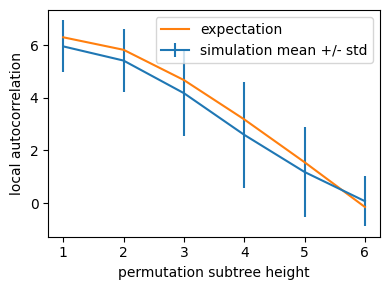

In [140]:
tree = Tree(make_binary_tree(height=6), format=1)
make_sim_vs_theoretical_plot(tree);

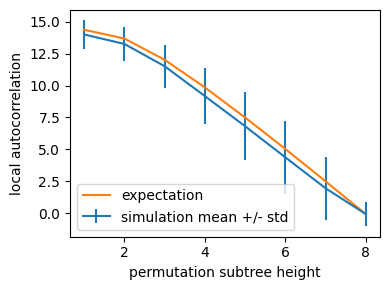

In [141]:
tree = Tree(make_binary_tree(height=8), format=1)
make_sim_vs_theoretical_plot(tree);

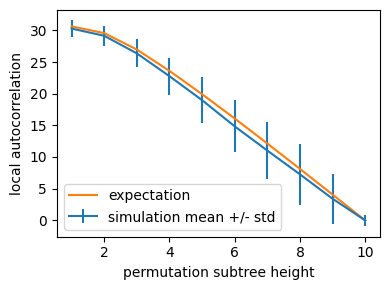

In [142]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree);

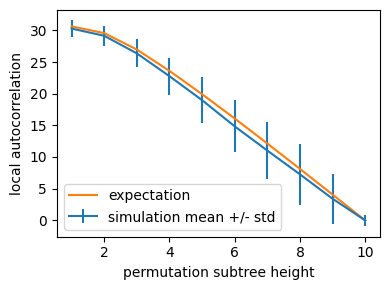

In [143]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree);

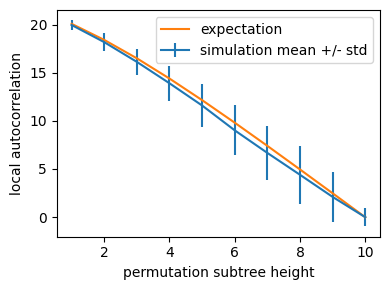

In [144]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree, gamma=1);

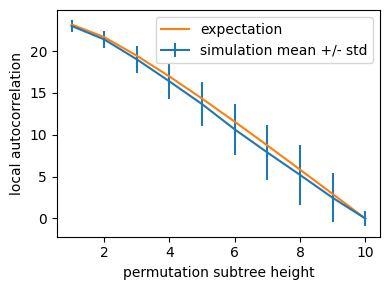

In [145]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree, gamma=5);

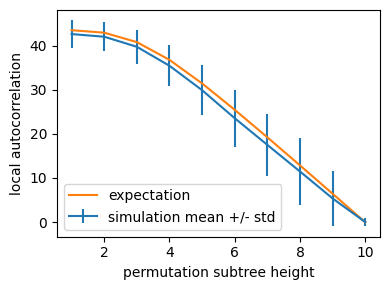

In [146]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree, gamma=20);

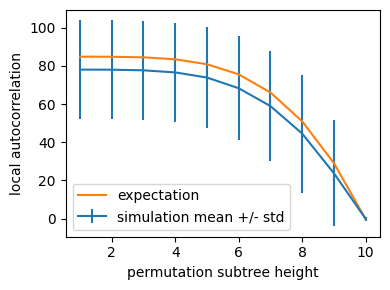

In [147]:
tree = Tree(make_binary_tree(height=10), format=1)
make_sim_vs_theoretical_plot(tree, gamma=100)

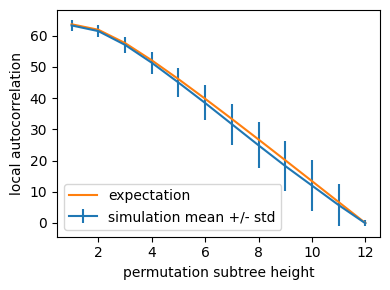

In [148]:
# takes ~15 mins to run
tree = Tree(make_binary_tree(height=12), format=1)
make_sim_vs_theoretical_plot(tree)

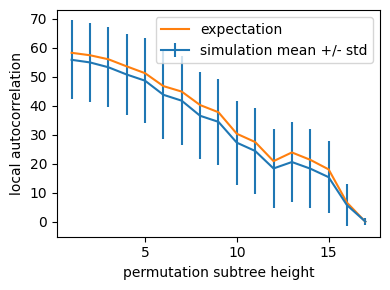

In [149]:
name = '3435_NT_T1'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)
make_sim_vs_theoretical_plot(tree)

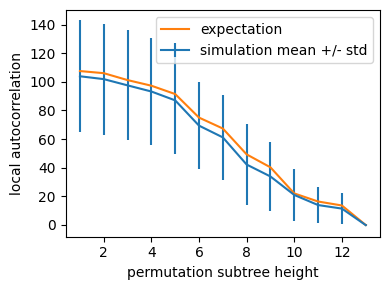

In [150]:
name = 'GSM3302829_embryo3'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)
make_sim_vs_theoretical_plot(tree)

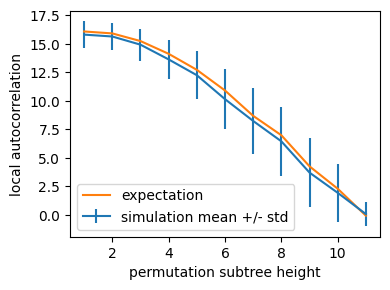

In [151]:
name = 'worm_avg_leaves'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)
make_sim_vs_theoretical_plot(tree)

# Figure S16 and S9

Orenstein Uhlenbeck process

## Iterative simulation

using exact OU update formula from Gillispie

In [152]:
# assume unit edge lengths delta t = 1
def generate_ou_data_from_tree(etree, dim, x0=0, tau=100, c=1, seed=12345, gene_prefix='g'):
  np.random.seed(seed)
  for node in etree.traverse('levelorder'):
    if node == etree:
      etree.add_features(x=x0)
    else:
      # Ornstein Uhlenbeck exact update formula
      node.add_features(
          x = node.up.x * np.exp(-1/tau) + np.sqrt(c * tau / 2 * (1 - np.exp(-2/tau))) * np.random.normal(size=dim, scale=1))

  leaves = etree.get_leaves()
  labels = []
  data = np.zeros((len(leaves), dim))
  for i, node in enumerate(leaves):
    labels.append(node.name)
    data[i] = node.x
  return pd.DataFrame(data, index=labels, columns=[f'{gene_prefix}{n:04d}' for n in range(dim)])


def compute_ou_sim_scores(tree, gamma=10, x0=0, tau=100, c=1):
  _, d = tree.get_farthest_leaf()
  d = int(d)
  expression_df = generate_ou_data_from_tree(tree, 100, x0=x0, tau=tau, c=c)
  N = len(expression_df)
  tree_dists, _ = get_tree_dists(tree, expression_df.index)
  np.random.seed(123121)
  sim_perm_lac_mean = np.zeros(d)
  sim_perm_lac_std = np.zeros(d)
  for j, perm_d in enumerate(range(1, d+1)):
    subsets = extract_subsets_with_height(
        tree, height=perm_d, include_labels=expression_df.index, return_ids=True)
    expression = expression_df.values + 0
    for i in range(100):
      perm_ids = get_permutation_ids(np.arange(N), subsets, seed=np.random.randint(1203232))
      expression[:, i] = expression[perm_ids][:, i]
    sim_perm_lac_mean[j], sim_perm_lac_std[j] = lac_empirical(tree_dists, expression, gamma=gamma)

  return sim_perm_lac_mean, sim_perm_lac_std, expression_df.index


def make_ou_sim_plot(tree, gamma=10, x0=0, tau=100, c=1):
  _, d = tree.get_farthest_leaf()
  d = int(d)
  sim_perm_lac_mean, sim_perm_lac_std, labels_in_order = compute_ou_sim_scores(tree, gamma=gamma, x0=x0, tau=tau, c=c)

  fig, ax = plt.subplots(figsize=(4, 3))
  ax.errorbar(np.arange(1, d+1), sim_perm_lac_mean, yerr=sim_perm_lac_std, label='simulation mean +/- std')
  ax.set_xlabel('permutation subtree height')
  ax.set_ylabel('local autocorrelation')
  ax.legend()
  fig.tight_layout()

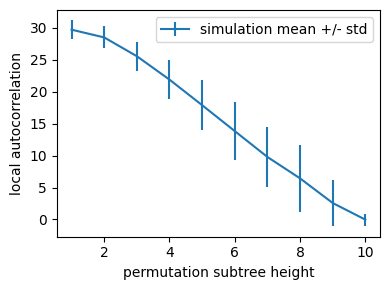

In [153]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, x0=0, tau=100, c=100)

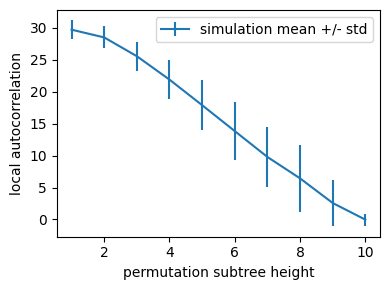

In [154]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, x0=0, tau=100, c=1)

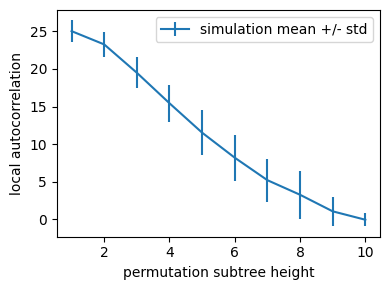

In [155]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, x0=0, tau=10, c=1)

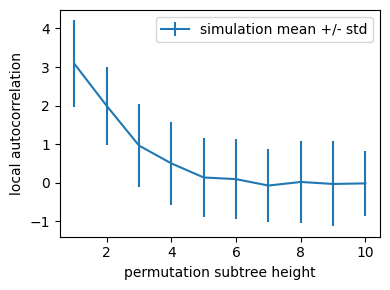

In [156]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, x0=0, tau=1, c=1)

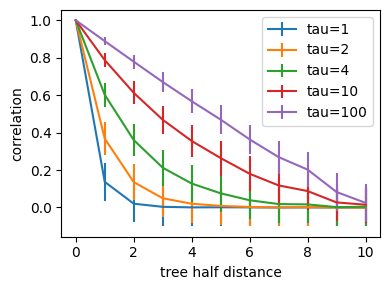

In [157]:
tree = Tree(make_binary_tree(height=10), format=1)

stats = {}
for tau in [1, 2, 4, 10, 100]:
  expression_df = generate_ou_data_from_tree(tree, 100, x0=0, tau=tau, c=1)
  N = len(expression_df)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)

  corrs = expression_df.T.corr().values
  upper_half_tree_dists = np.triu(tree_dists) / 2
  D = int(np.max(upper_half_tree_dists))
  corr_means = [1]
  corr_stds = [0]
  for d in range(1, D+1):
    idx = np.argwhere(upper_half_tree_dists == d)
    d_corrs = corrs[idx[:,0], idx[:, 1]]
    corr_means.append(np.mean(d_corrs))
    corr_stds.append(np.std(d_corrs))
  stats[tau] = (corr_means, corr_stds)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(0, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('tree half distance')
ax.set_ylabel('correlation')
ax.legend()
fig.tight_layout()

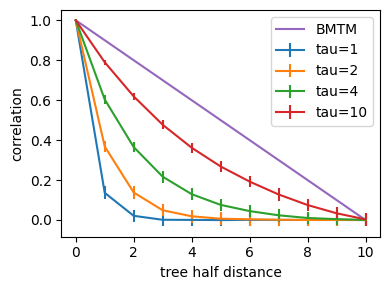

In [158]:
tree = Tree(make_binary_tree(height=10), format=1)

stats = {}
for tau in [1, 2, 4, 10]:
  expression_df = generate_ou_data_from_tree(tree, 1000, x0=0, tau=tau, c=1, seed=412154)
  N = len(expression_df)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)

  corrs = expression_df.T.corr().values
  upper_half_tree_dists = np.triu(tree_dists) / 2
  D = int(np.max(upper_half_tree_dists))
  corr_means = [1]
  corr_stds = [0]
  for d in range(1, D+1):
    idx = np.argwhere(upper_half_tree_dists == d)
    d_corrs = corrs[idx[:,0], idx[:, 1]]
    corr_means.append(np.mean(d_corrs))
    corr_stds.append(np.std(d_corrs))
  stats[tau] = (corr_means, corr_stds)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(0, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')

ds = np.arange(0, D+1)
ax.plot(ds, 1 - np.arange(0, D+1)/D, label='BMTM')
ax.set_xlabel('tree half distance')
ax.set_ylabel('correlation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [01:11<00:00, 14.22s/it]


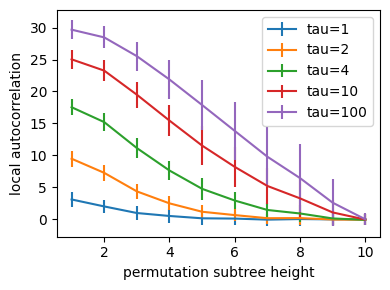

In [159]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for tau in tqdm([1, 2, 4, 10, 100]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(1, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [01:09<00:00, 13.90s/it]


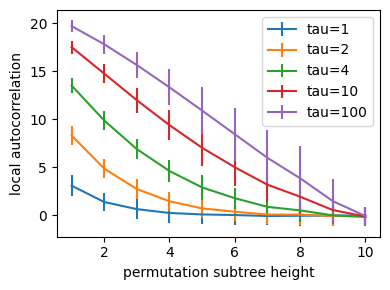

In [160]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for tau in tqdm([1, 2, 4, 10, 100]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=1, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(1, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [01:03<00:00, 12.63s/it]


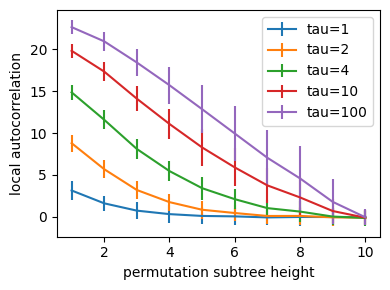

In [161]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for tau in tqdm([1, 2, 4, 10, 100]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=5, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(1, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:56<00:00, 11.37s/it]


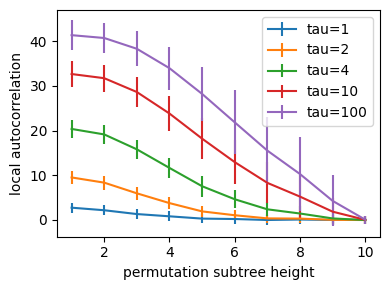

In [162]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for tau in tqdm([1, 2, 4, 10, 100]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=20, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(1, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:57<00:00, 11.47s/it]


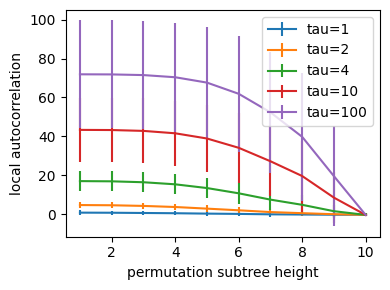

In [163]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for tau in tqdm([1, 2, 4, 10, 100]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=100, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10, 100]:
  ax.errorbar(np.arange(1, D+1), stats[tau][0], yerr=stats[tau][1], label=f'tau={tau}')
ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:16<00:00, 19.11s/it]


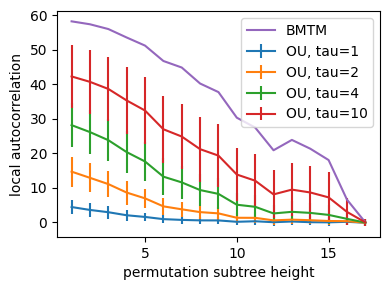

In [164]:
name = '3435_NT_T1'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')


theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [02:12<00:00, 33.21s/it]


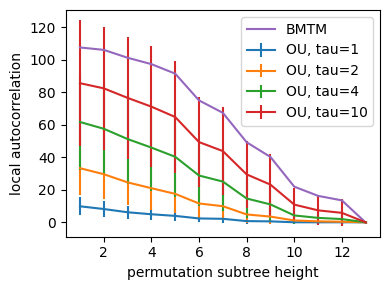

In [165]:
name = 'GSM3302829_embryo3'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


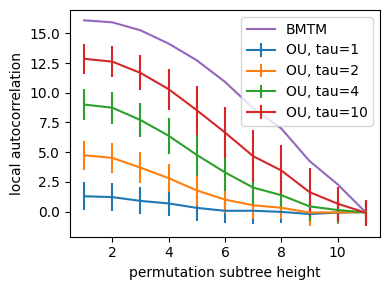

In [166]:
name = 'worm_avg_leaves'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:54<00:00, 13.52s/it]


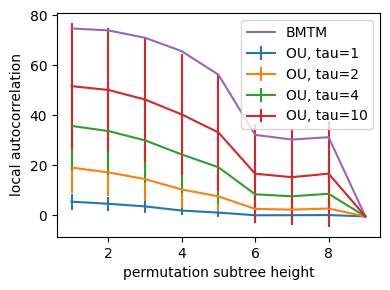

In [167]:
name = 'GSE117542_embryo2'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:42<00:00, 25.59s/it]


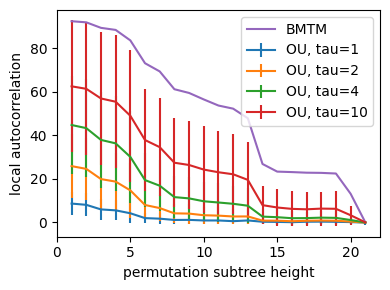

In [168]:
name = '3730_NT_T1'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:29<00:00,  7.41s/it]


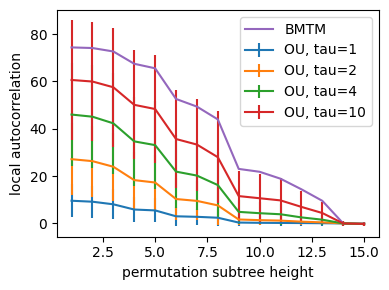

In [169]:
name = '3726_NT_T1'
tree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', format=1, quoted_node_names=True)

_, d = tree.get_farthest_leaf()
d = int(d)

stats = {}
for tau in tqdm([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, x0=0, tau=tau, c=1)
  stats[tau] = (perm_lac_mean, sim_perm_lac_std)

fig, ax = plt.subplots(figsize=(4, 3))
for tau in [1, 2, 4, 10]:
  ax.errorbar(np.arange(1, d+1), stats[tau][0], yerr=stats[tau][1], label=f'OU, tau={tau}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, d+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

## Simulation with MVN

using covariance matrix from hansen and martin

formula is only applicable to trees where all leaves have same distance to root (number of generations)

In [170]:
# assume unit edge lengths delta t = 1
def generate_ou_data_from_tree(etree, dim, w=1/100, v=1, seed=12345, gene_prefix='g'):
  np.random.seed(seed)

  _, d = tree.get_farthest_leaf()
  d = int(d)
  labels = [n.name for n in etree.get_leaves()]
  n = len(labels)
  tree_dists, _ = get_tree_dists(tree, labels)

  cov = (np.exp(- v * w * tree_dists) - np.exp(-2 * v * w * d)) / (2 * n * w)
  data = np.random.multivariate_normal(np.zeros(n), cov, size=dim).T

  return pd.DataFrame(data, index=labels, columns=[f'{gene_prefix}{n:04d}' for n in range(dim)])


def compute_ou_sim_scores(tree, gamma=10, w=1/100, v=1):
  _, d = tree.get_farthest_leaf()
  d = int(d)
  expression_df = generate_ou_data_from_tree(tree, 100, w=w, v=v)
  N = len(expression_df)
  tree_dists, _ = get_tree_dists(tree, expression_df.index)
  np.random.seed(123121)
  sim_perm_lac_mean = np.zeros(d)
  sim_perm_lac_std = np.zeros(d)
  for j, perm_d in enumerate(range(1, d+1)):
    subsets = extract_subsets_with_height(
        tree, height=perm_d, include_labels=expression_df.index, return_ids=True)
    expression = expression_df.values + 0
    for i in range(100):
      perm_ids = get_permutation_ids(np.arange(N), subsets, seed=np.random.randint(1203232))
      expression[:, i] = expression[perm_ids][:, i]
    sim_perm_lac_mean[j], sim_perm_lac_std[j] = lac_empirical(tree_dists, expression, gamma=gamma)

  return sim_perm_lac_mean, sim_perm_lac_std, expression_df.index


def make_ou_sim_plot(tree, gamma=10, w=1/100, v=1):
  _, d = tree.get_farthest_leaf()
  d = int(d)
  sim_perm_lac_mean, sim_perm_lac_std, labels_in_order = compute_ou_sim_scores(tree, gamma=gamma, w=w, v=v)

  fig, ax = plt.subplots(figsize=(4, 3))
  ax.errorbar(np.arange(1, d+1), sim_perm_lac_mean, yerr=sim_perm_lac_std, label='simulation mean +/- std')
  ax.set_xlabel('permutation subtree height')
  ax.set_ylabel('local autocorrelation')
  ax.legend()
  fig.tight_layout()

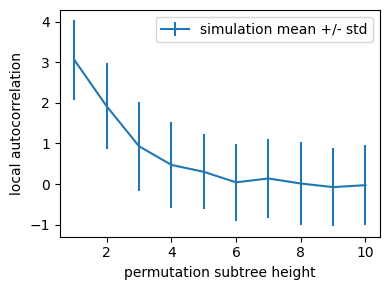

In [171]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, w=1/100, v=100)

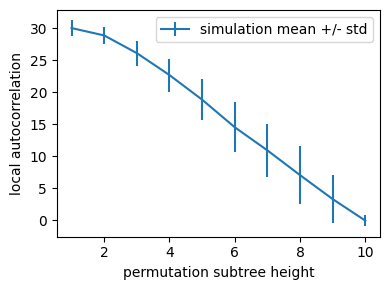

In [172]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, w=1/100, v=1)

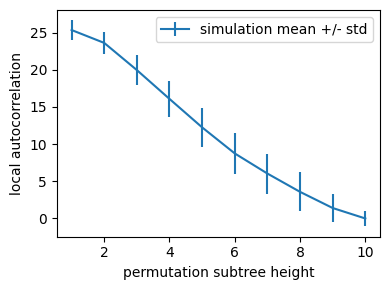

In [173]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, w=1/10, v=1)

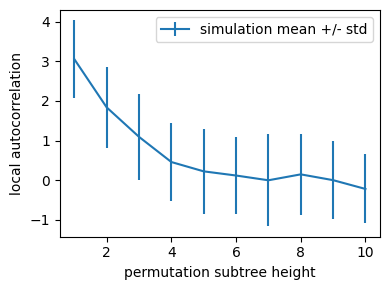

In [174]:
tree = Tree(make_binary_tree(height=10), format=1)
make_ou_sim_plot(tree, gamma=10, w=1/1, v=1)

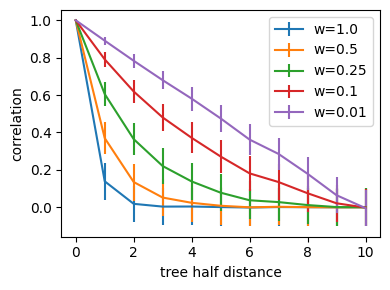

In [175]:
tree = Tree(make_binary_tree(height=10), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10, 100]):
  expression_df = generate_ou_data_from_tree(tree, 100, w=w, v=1)
  N = len(expression_df)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)

  corrs = expression_df.T.corr().values
  upper_half_tree_dists = np.triu(tree_dists) / 2
  D = int(np.max(upper_half_tree_dists))
  corr_means = [1]
  corr_stds = [0]
  for d in range(1, D+1):
    idx = np.argwhere(upper_half_tree_dists == d)
    d_corrs = corrs[idx[:,0], idx[:, 1]]
    corr_means.append(np.mean(d_corrs))
    corr_stds.append(np.std(d_corrs))
  stats[w] = (corr_means, corr_stds)

fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10, 100]):
  ax.errorbar(np.arange(0, D+1), stats[w][0], yerr=stats[w][1], label=f'w={w}')
ax.set_xlabel('tree half distance')
ax.set_ylabel('correlation')
ax.legend()
fig.tight_layout()

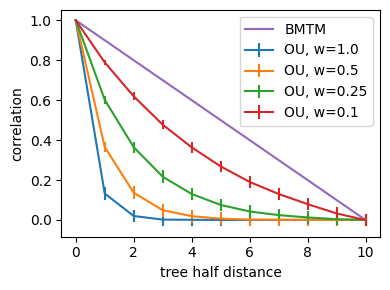

In [176]:
tree = Tree(make_binary_tree(height=10), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10]):
  expression_df = generate_ou_data_from_tree(tree, 1000, w=w, v=1)
  N = len(expression_df)
  tree_dists, mrca_depths = get_tree_dists(tree, expression_df.index)

  corrs = expression_df.T.corr().values
  upper_half_tree_dists = np.triu(tree_dists) / 2
  D = int(np.max(upper_half_tree_dists))
  corr_means = [1]
  corr_stds = [0]
  for d in range(1, D+1):
    idx = np.argwhere(upper_half_tree_dists == d)
    d_corrs = corrs[idx[:,0], idx[:, 1]]
    corr_means.append(np.mean(d_corrs))
    corr_stds.append(np.std(d_corrs))
  stats[w] = (corr_means, corr_stds)

fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10]):
  ax.errorbar(np.arange(0, D+1), stats[w][0], yerr=stats[w][1], label=f'OU, w={w}')

ds = np.arange(0, D+1)
ax.plot(ds, 1 - np.arange(0, D+1)/D, label='BMTM')
ax.set_xlabel('tree half distance')
ax.set_ylabel('correlation')
ax.legend()
fig.tight_layout()

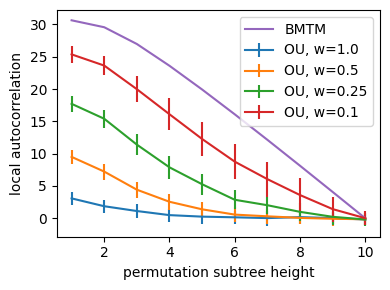

In [177]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=10, w=w, v=1)
  stats[w] = (perm_lac_mean, sim_perm_lac_std)


fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10]):
  ax.errorbar(np.arange(1, D+1), stats[w][0], yerr=stats[w][1], label=f'OU, w={w}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=10)
ax.plot(np.arange(1, D+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

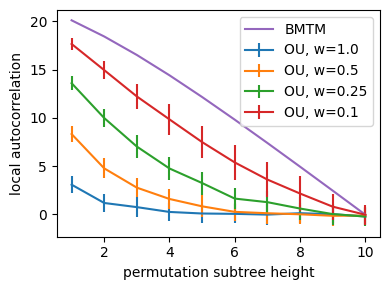

In [178]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=1, w=w, v=1)
  stats[w] = (perm_lac_mean, sim_perm_lac_std)


fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10]):
  ax.errorbar(np.arange(1, D+1), stats[w][0], yerr=stats[w][1], label=f'OU, w={w}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=1)
ax.plot(np.arange(1, D+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

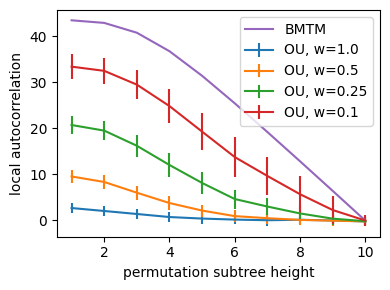

In [179]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=20, w=w, v=1)
  stats[w] = (perm_lac_mean, sim_perm_lac_std)


fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10]):
  ax.errorbar(np.arange(1, D+1), stats[w][0], yerr=stats[w][1], label=f'OU, w={w}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=20)
ax.plot(np.arange(1, D+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

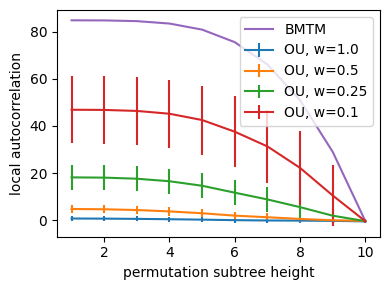

In [180]:
D = 10
tree = Tree(make_binary_tree(height=D), format=1)

stats = {}
for w in 1/np.array([1, 2, 4, 10]):
  perm_lac_mean, sim_perm_lac_std, _ = compute_ou_sim_scores(tree, gamma=100, w=w, v=1)
  stats[w] = (perm_lac_mean, sim_perm_lac_std)


fig, ax = plt.subplots(figsize=(4, 3))
for w in 1/np.array([1, 2, 4, 10]):
  ax.errorbar(np.arange(1, D+1), stats[w][0], yerr=stats[w][1], label=f'OU, w={w}')

theo_perm_lac = get_expected_lac_bmtm_height_perm(tree, np.array([n.name for n in tree.get_leaves()]), gamma=100)
ax.plot(np.arange(1, D+1), theo_perm_lac['lac'], label='BMTM')

ax.set_xlabel('permutation subtree height')
ax.set_ylabel('local autocorrelation')
ax.legend()
fig.tight_layout()

# Figure S18

## Expected and real local autocorrelation

In [181]:
def real_vs_expected_lac(name, title, gamma=10):
  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  etree = Tree(f'{data_path}/preprocessed/{name}_pruned.nwk', quoted_node_names=True, format=1)
  expected_lac = get_expected_lac_bmtm_height_perm(etree, expression.index, gamma=gamma)
  agg = get_perm_dists(expression, tree_path=f'{data_path}/preprocessed/{name}_pruned.nwk', decay_factor=gamma)

  fig, ax = plt.subplots(1, 1, figsize=(5, 4))
  ax.plot(expected_lac['height'], expected_lac['lac'], 'x--', label='expected under BMTM')
  ax.set_xlabel('subtree height for permutation', fontsize=18)
  ax.set_ylabel('local autocorrelation', fontsize=18)
  ax.tick_params(axis='x', which='major', labelsize=12)
  ax.tick_params(axis='y', which='major', labelsize=12, labelcolor='tab:blue')
  ax.set_title(f'{title}', fontsize=18)
  ax2 = ax.twinx()
  ax2.errorbar(agg.index, agg[f'la_expression_mean'], yerr=agg[f'la_expression_std'],
                label=f'data mean +/- std', color='red', fmt='--', capsize=5)
  ax2.tick_params(axis='y', which='major', labelsize=12, labelcolor='red')
  ax.set_xticks(expected_lac.index.values[::2].tolist())

  lines, labels = ax.get_legend_handles_labels()
  lines2, labels2 = ax2.get_legend_handles_labels()
  ax2.legend(lines + lines2, labels + labels2, prop={'size': 12}, loc='lower left')

  fig.tight_layout()
  return fig

## Gamma=10

In [182]:
gamma = 10

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:05<00:00,  2.17it/s]


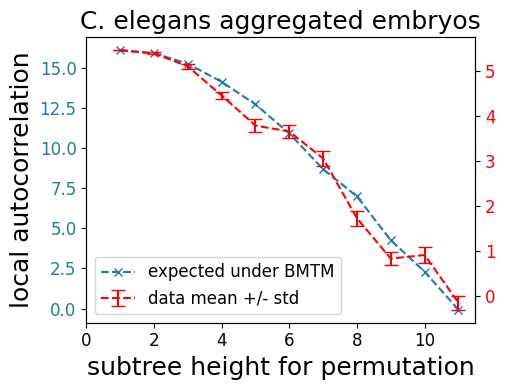

In [183]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos', gamma=gamma);

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [01:19<00:00,  8.84s/it]


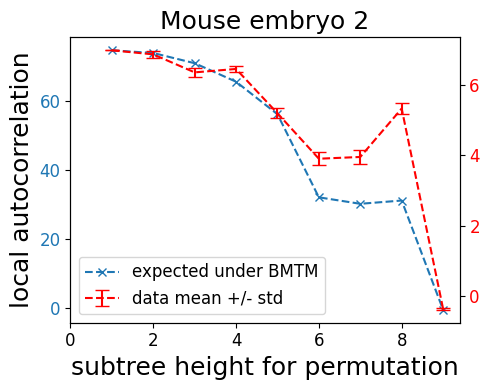

In [184]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [08:35<00:00, 39.66s/it]


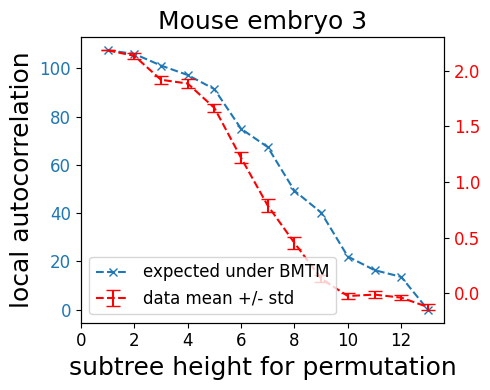

In [185]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:26<00:00,  1.53s/it]


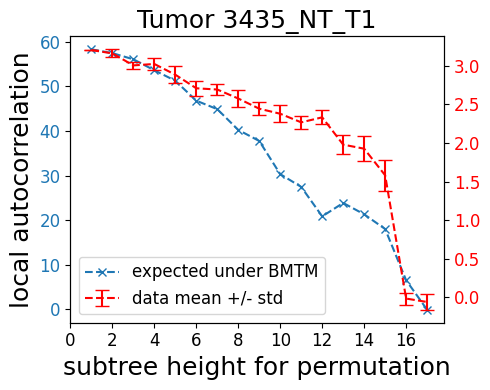

In [186]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:42<00:00,  2.03s/it]


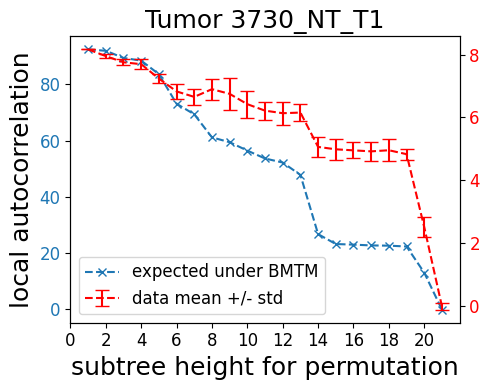

In [187]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:13<00:00,  1.09it/s]


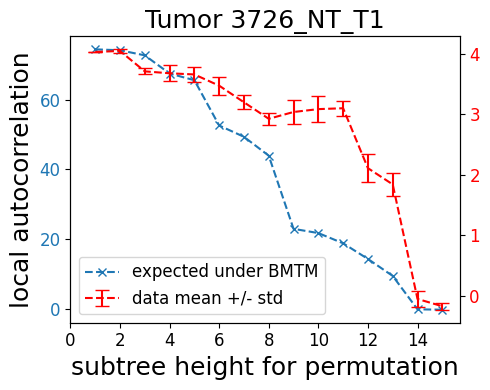

In [188]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1', gamma=gamma);

## Gamma=1

In [189]:
gamma = 1

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:16<00:00,  1.47s/it]


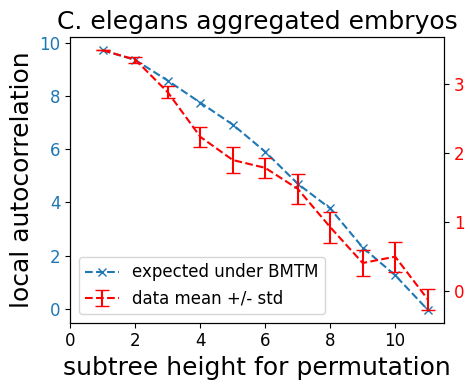

In [190]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos', gamma=gamma);

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [03:56<00:00, 26.30s/it]


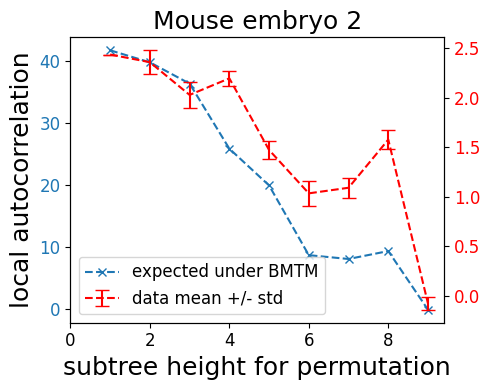

In [191]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [06:33<00:00, 30.26s/it]


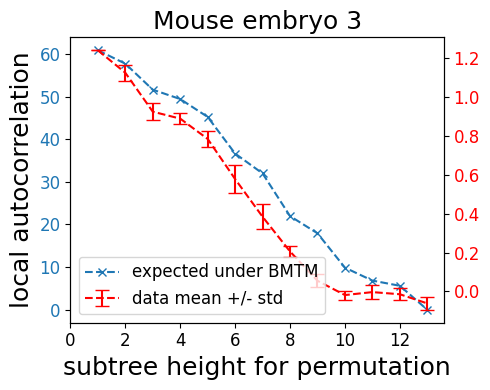

In [192]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:22<00:00,  1.33s/it]


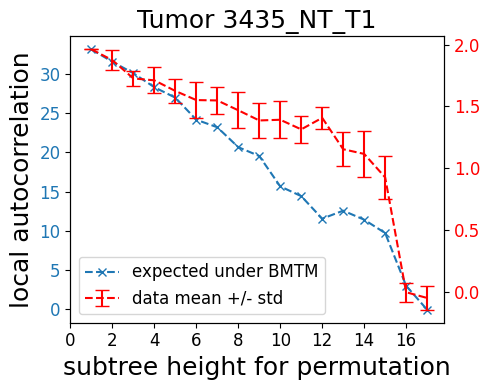

In [193]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:30<00:00,  1.45s/it]


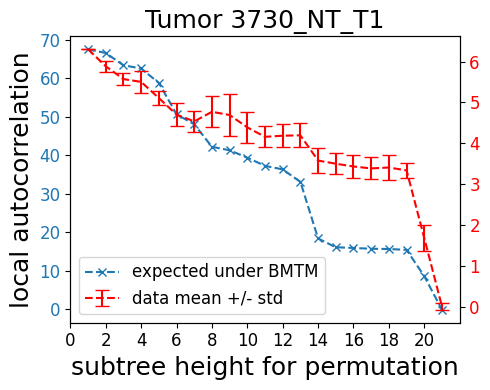

In [194]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:09<00:00,  1.63it/s]


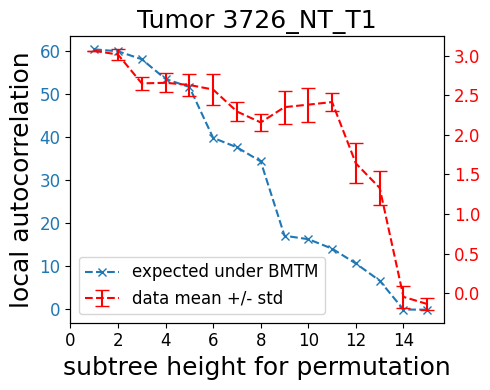

In [195]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1', gamma=gamma);

## Gamma=5

In [196]:
gamma = 5

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:10<00:00,  1.01it/s]


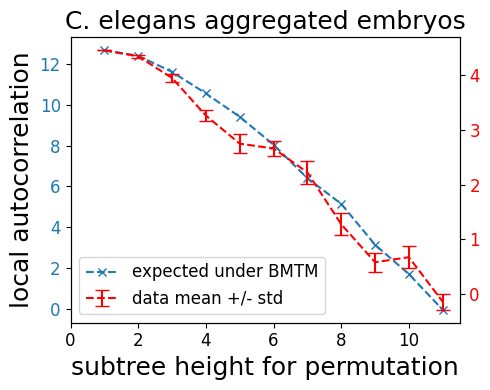

In [197]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos', gamma=gamma);

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [02:51<00:00, 19.05s/it]


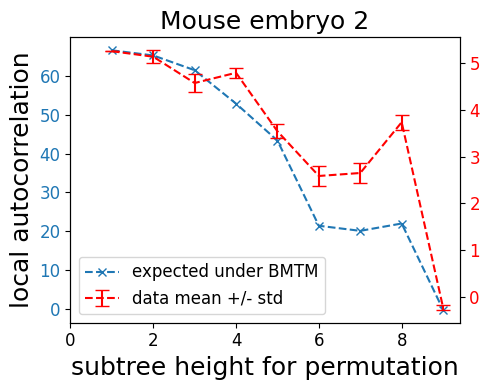

In [198]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [06:33<00:00, 30.28s/it]


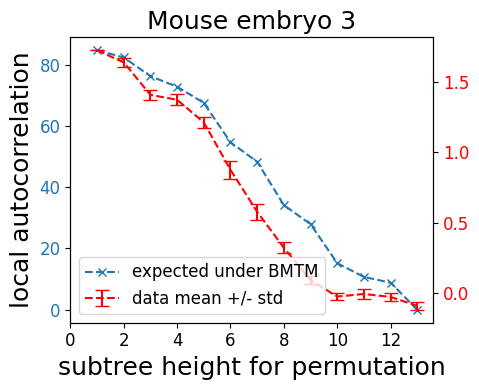

In [199]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:22<00:00,  1.33s/it]


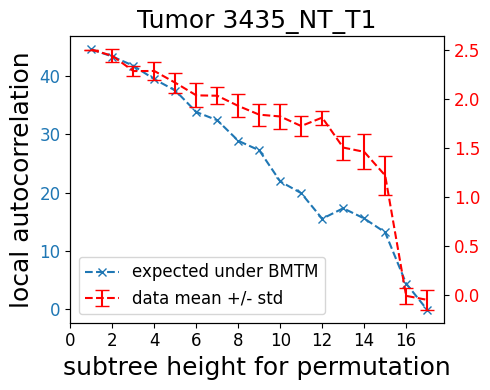

In [200]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:30<00:00,  1.45s/it]


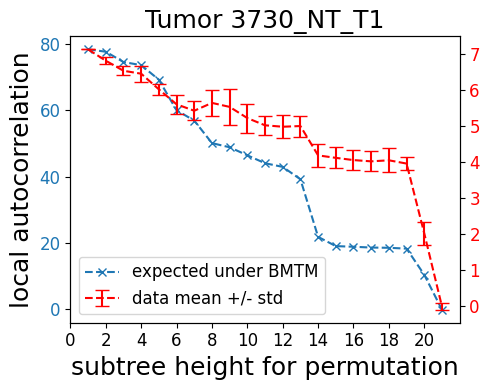

In [201]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:09<00:00,  1.58it/s]


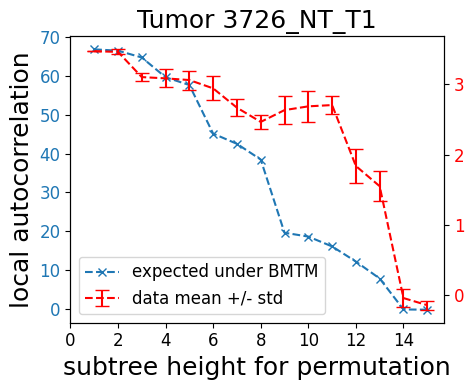

In [202]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1', gamma=gamma);

## Gamma=20

In [203]:
gamma = 20

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:10<00:00,  1.01it/s]


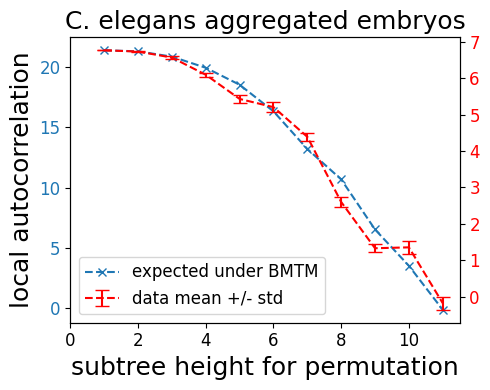

In [204]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos', gamma=gamma);

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [02:51<00:00, 19.05s/it]


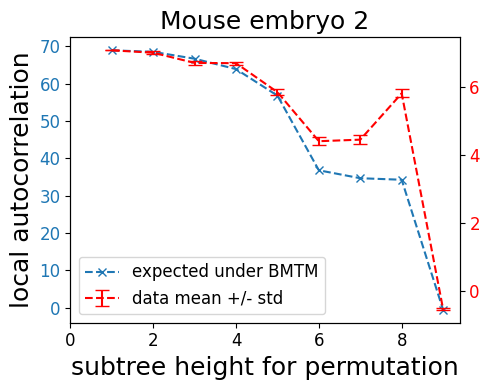

In [205]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [06:33<00:00, 30.24s/it]


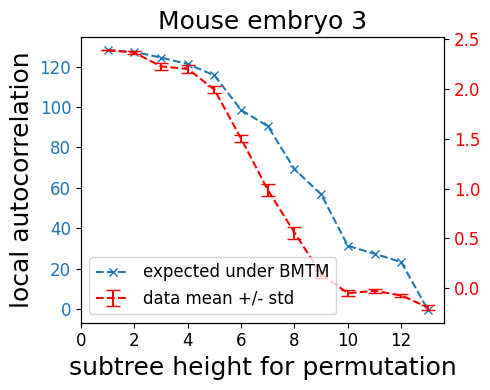

In [206]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:22<00:00,  1.31s/it]


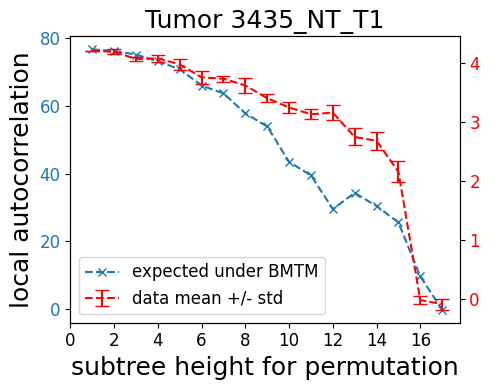

In [207]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:30<00:00,  1.43s/it]


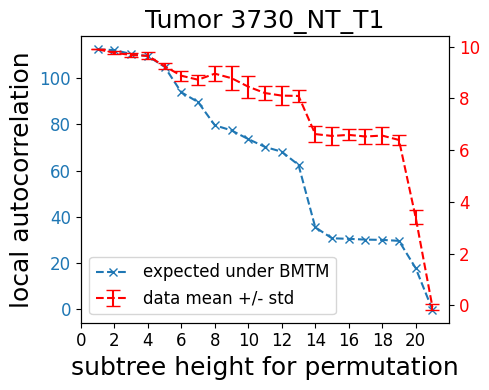

In [208]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:09<00:00,  1.63it/s]


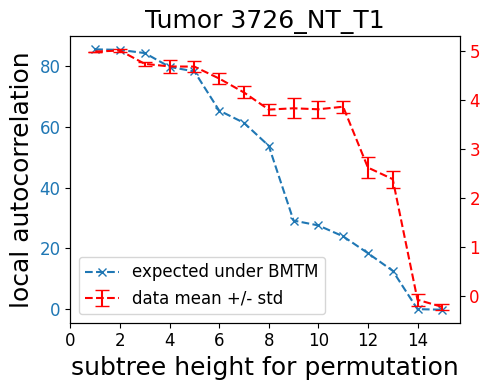

In [209]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1', gamma=gamma);

## Gamma=100

In [210]:
gamma = 100

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:10<00:00,  1.01it/s]


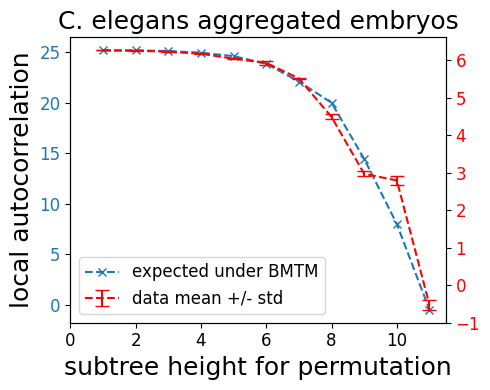

In [211]:
real_vs_expected_lac('worm_avg_leaves', 'C. elegans aggregated embryos', gamma=gamma);

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [02:51<00:00, 19.05s/it]


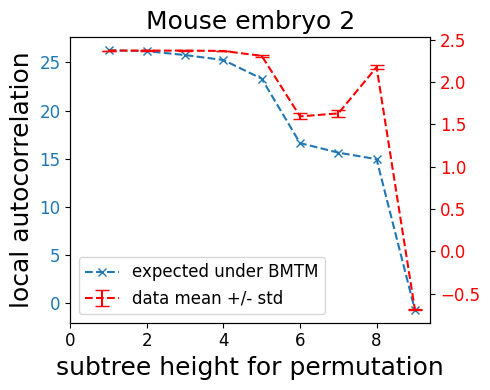

In [212]:
real_vs_expected_lac('GSE117542_embryo2', 'Mouse embryo 2', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [06:33<00:00, 30.26s/it]


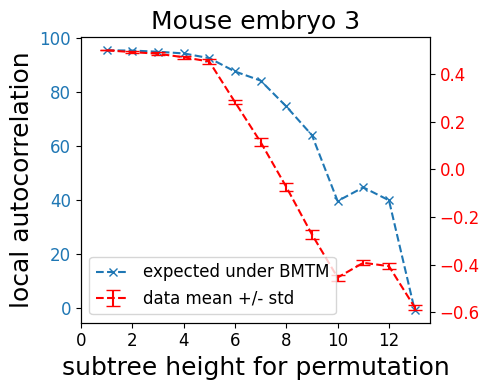

In [213]:
real_vs_expected_lac('GSM3302829_embryo3', 'Mouse embryo 3', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:22<00:00,  1.30s/it]


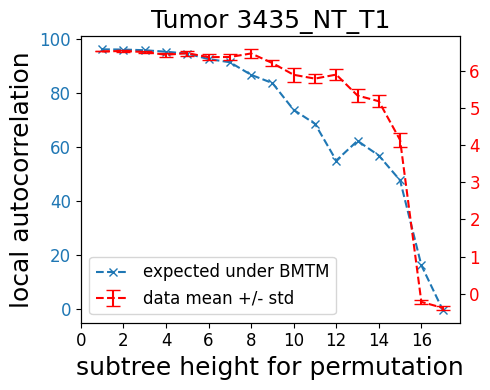

In [214]:
real_vs_expected_lac('3435_NT_T1', 'Tumor 3435_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:30<00:00,  1.44s/it]


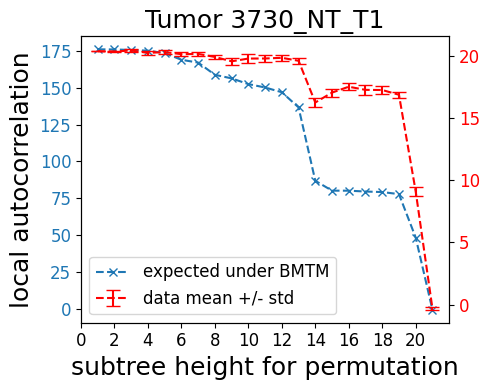

In [215]:
real_vs_expected_lac('3730_NT_T1', 'Tumor 3730_NT_T1', gamma=gamma);

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:09<00:00,  1.63it/s]


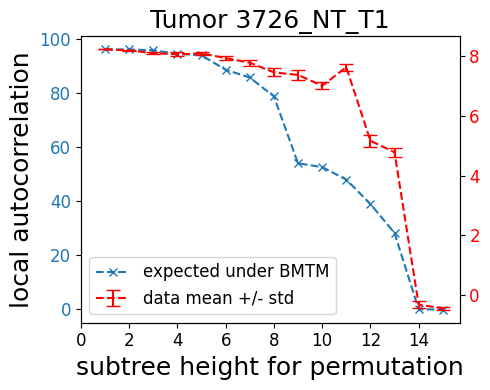

: 

In [216]:
real_vs_expected_lac('3726_NT_T1', 'Tumor 3726_NT_T1', gamma=gamma);